# Build a Conditional GAN

### Goals
In this notebook, I am going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let me choose what digit I want to generate.



## Getting Started

the MNIST dataset is used , We can applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.


#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. 



In [4]:


import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    
    return F.one_hot(labels, num_classes= n_classes)
    

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.




In [6]:

def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes)
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    
    combined = torch.cat((x.float(),y.float()),1)
   
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training

First,  define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

 parameters :

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [11]:

def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] +n_classes
    
    return generator_input_dim, discriminator_im_chan

In [12]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [13]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.319447260260582, discriminator loss: 0.23167101886868477


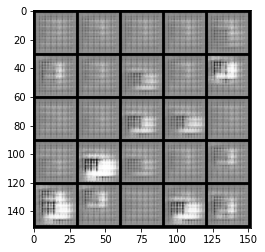

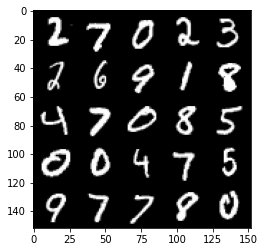

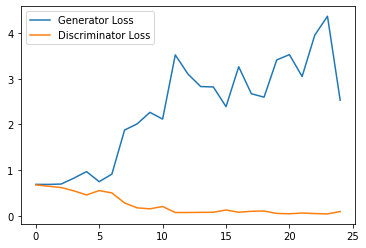

Step 1000: Generator loss: 4.916533738613128, discriminator loss: 0.03563512250455096


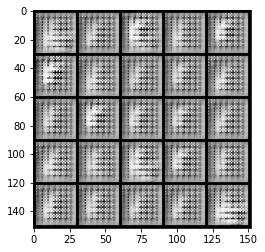

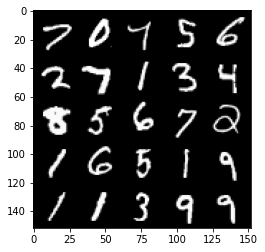

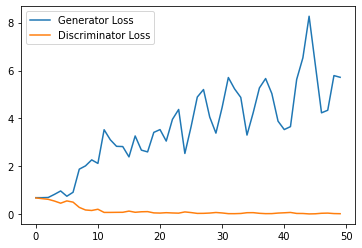

Step 1500: Generator loss: 6.00507984828949, discriminator loss: 0.013135761338751764


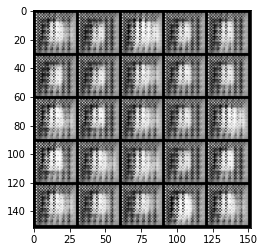

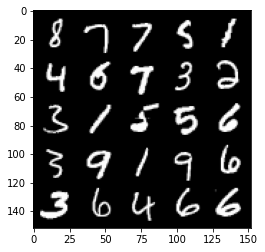

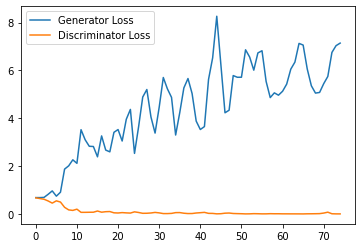

Step 2000: Generator loss: 5.864603414535522, discriminator loss: 0.01616201095189899


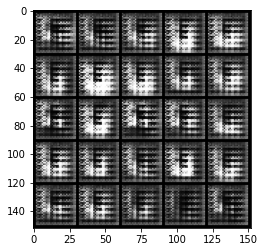

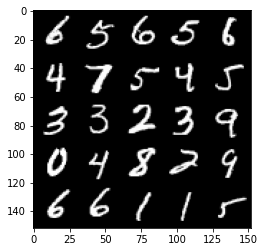

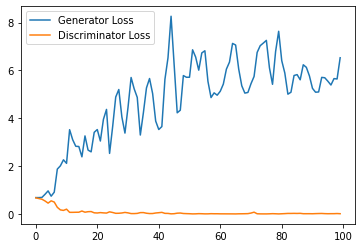

Step 2500: Generator loss: 6.164375367164612, discriminator loss: 0.018819024097174408


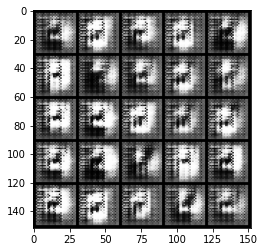

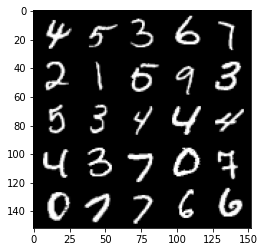

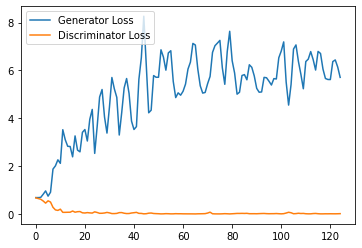

Step 3000: Generator loss: 4.958336193084717, discriminator loss: 0.031944307692814616


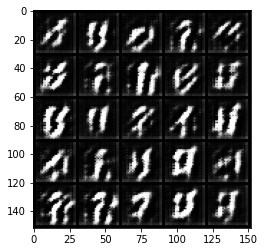

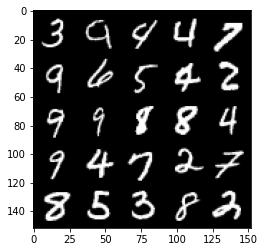

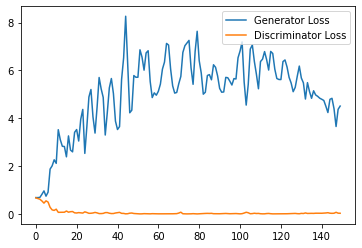

Step 3500: Generator loss: 4.109804693222046, discriminator loss: 0.08963047184422612


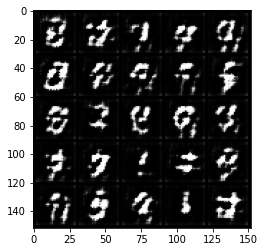

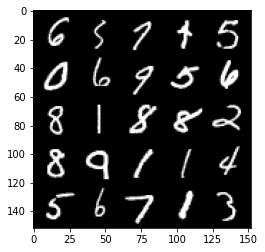

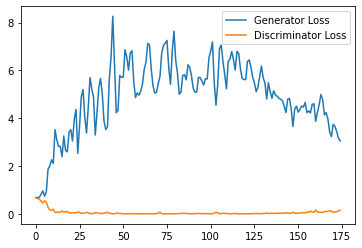

Step 4000: Generator loss: 3.02297594833374, discriminator loss: 0.1584290797561407


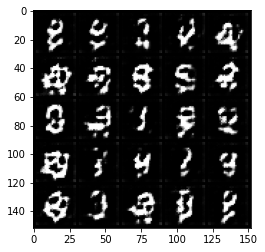

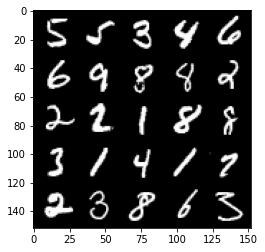

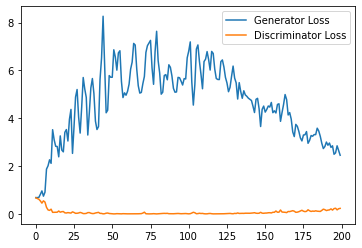

Step 4500: Generator loss: 2.6726533837318422, discriminator loss: 0.22810742607712745


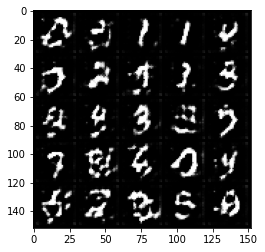

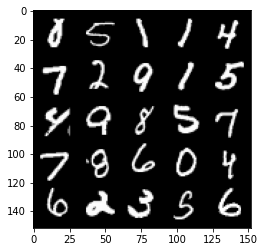

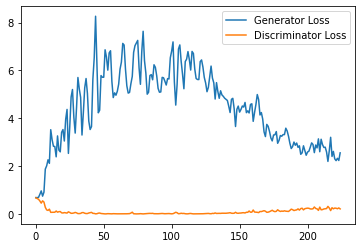

Step 5000: Generator loss: 2.396564881324768, discriminator loss: 0.2577002198547125


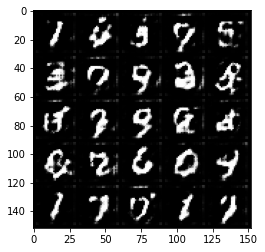

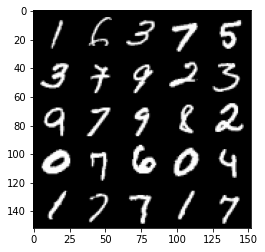

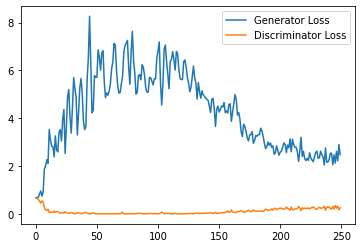

Step 5500: Generator loss: 2.5083851635456087, discriminator loss: 0.2559049266576767


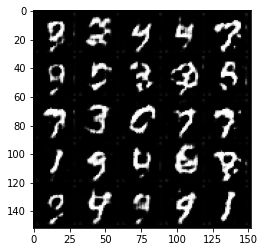

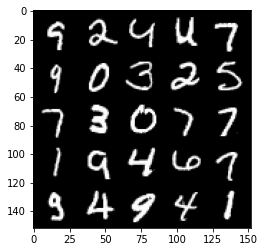

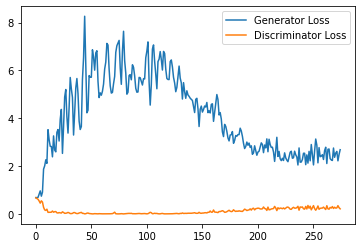

Step 6000: Generator loss: 2.3642119669914248, discriminator loss: 0.3110173998475075


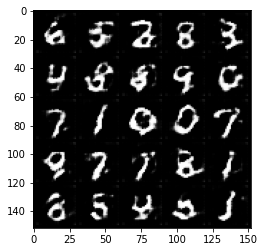

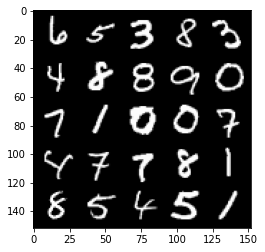

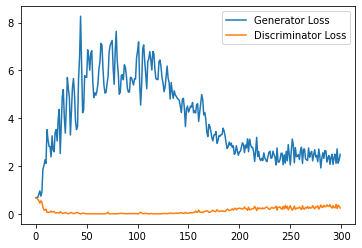

Step 6500: Generator loss: 2.1118002064228056, discriminator loss: 0.3109234053194523


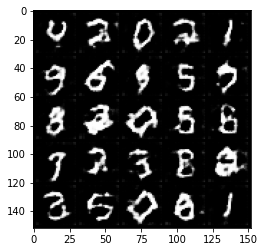

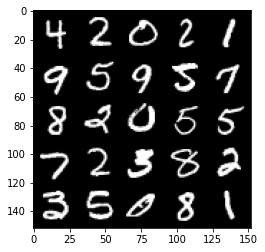

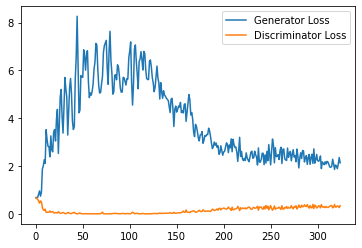

Step 7000: Generator loss: 1.9811380882263183, discriminator loss: 0.33095273610949516


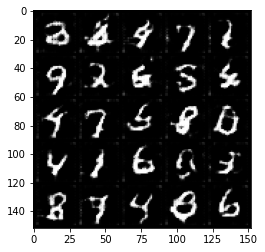

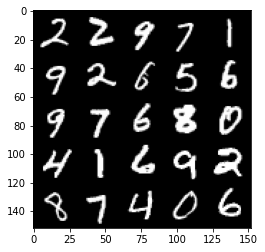

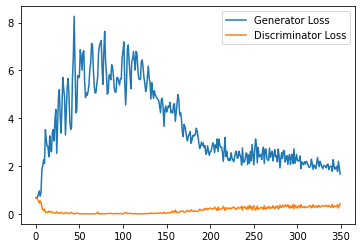

Step 7500: Generator loss: 1.967090189218521, discriminator loss: 0.33851375269889833


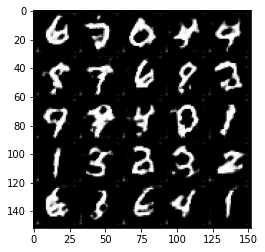

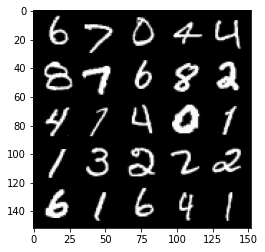

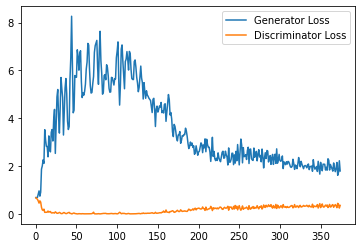

Step 8000: Generator loss: 1.9280536079406738, discriminator loss: 0.35891925209760667


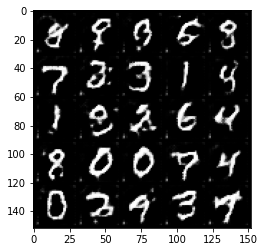

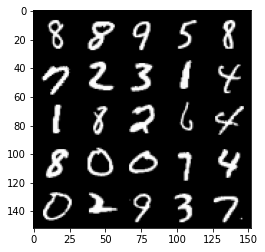

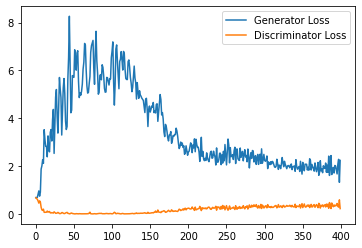

Step 8500: Generator loss: 1.785535812854767, discriminator loss: 0.3769502899646759


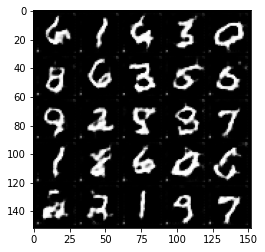

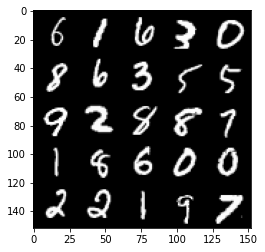

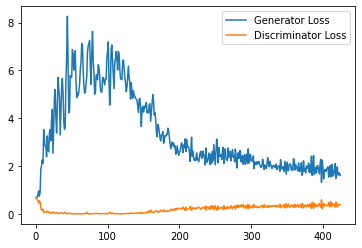

Step 9000: Generator loss: 1.7176825609207154, discriminator loss: 0.40137334376573564


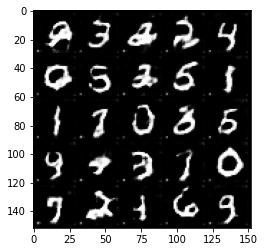

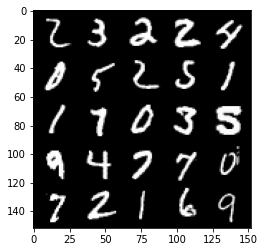

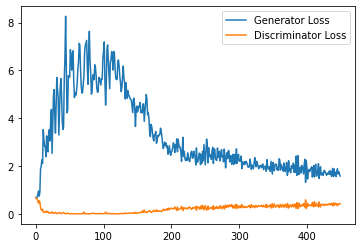

Step 9500: Generator loss: 1.6348157554864884, discriminator loss: 0.42116401040554047


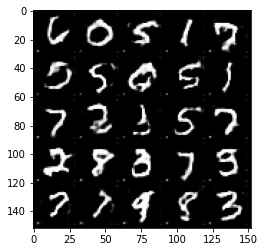

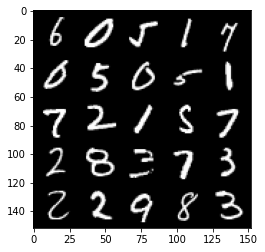

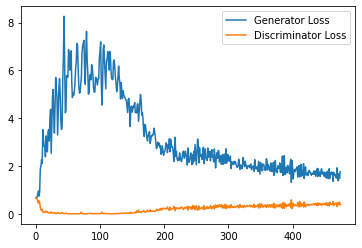

Step 10000: Generator loss: 1.5255929973125457, discriminator loss: 0.4600725468993187


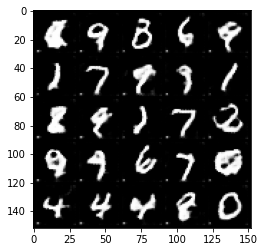

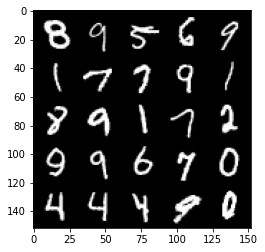

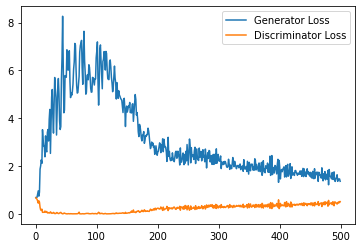

Step 10500: Generator loss: 1.5629139215946197, discriminator loss: 0.47314350521564486


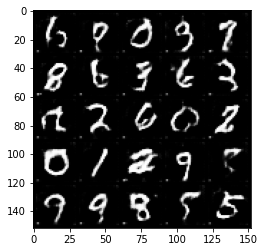

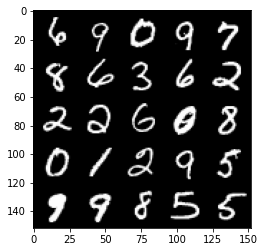

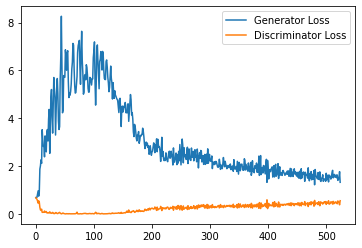

Step 11000: Generator loss: 1.4496858419179917, discriminator loss: 0.4864954928159714


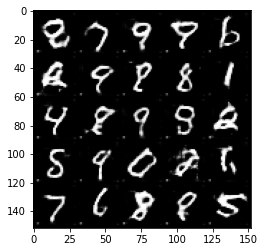

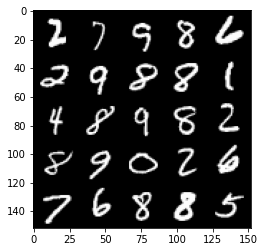

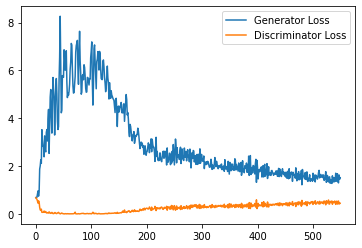

Step 11500: Generator loss: 1.3876367597579955, discriminator loss: 0.4909985582232475


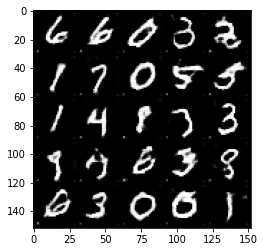

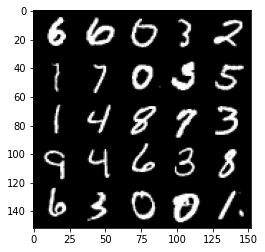

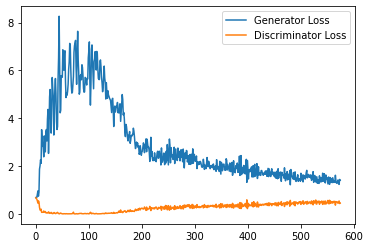

Step 12000: Generator loss: 1.320299030303955, discriminator loss: 0.5002013379335404


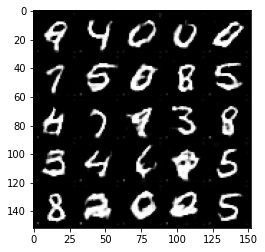

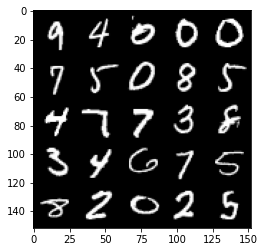

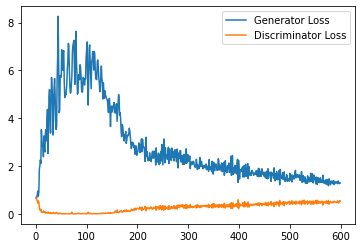

Step 12500: Generator loss: 1.3382086693048476, discriminator loss: 0.5146656950116157


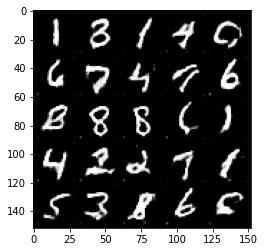

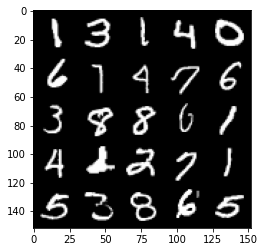

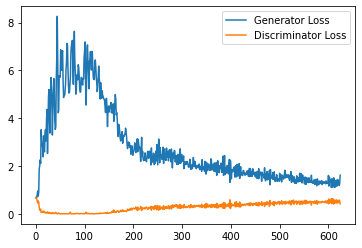

Step 13000: Generator loss: 1.3472624343633652, discriminator loss: 0.5322585518956184


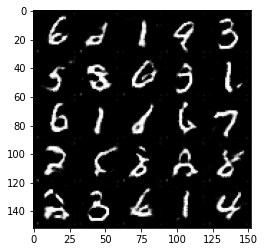

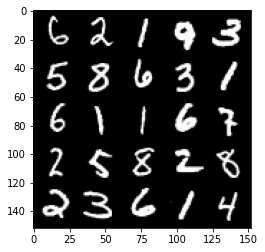

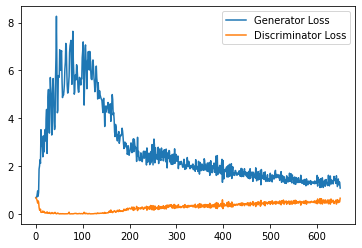

Step 13500: Generator loss: 1.2882698916196824, discriminator loss: 0.5352614424228668


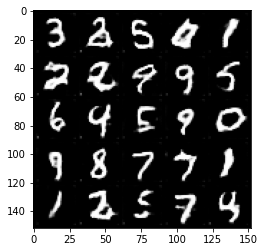

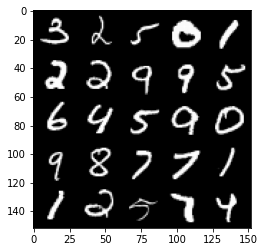

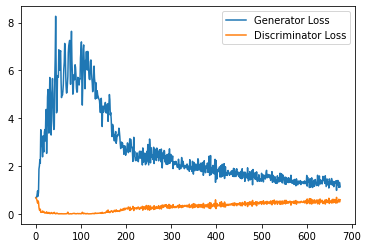

Step 14000: Generator loss: 1.2299442994594574, discriminator loss: 0.5432601798176765


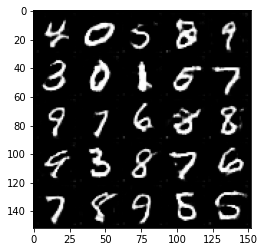

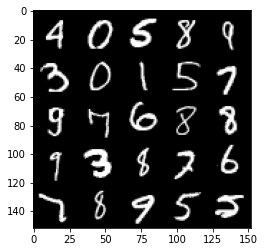

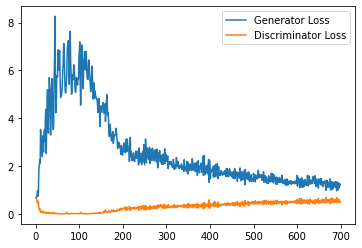

Step 14500: Generator loss: 1.2029721958637238, discriminator loss: 0.5637549698352814


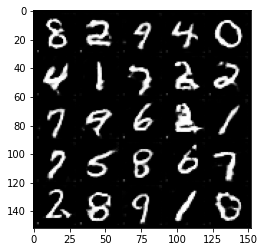

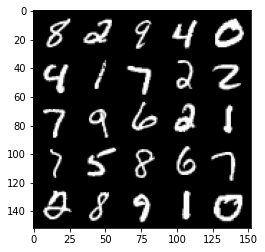

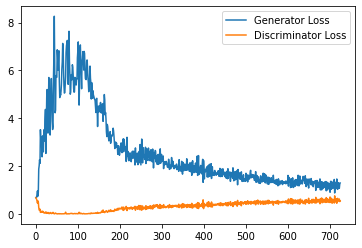

Step 15000: Generator loss: 1.2250587590932847, discriminator loss: 0.5703313611745834


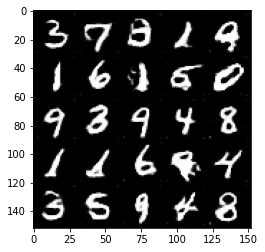

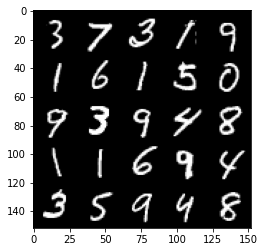

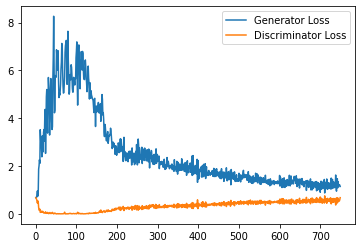

Step 15500: Generator loss: 1.2292417833805085, discriminator loss: 0.5494804831743241


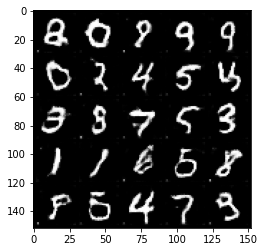

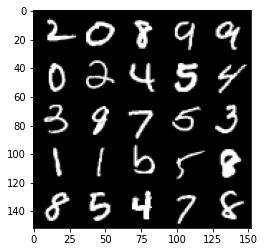

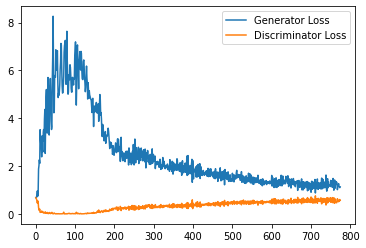

Step 16000: Generator loss: 1.1677544490098952, discriminator loss: 0.5616307621598243


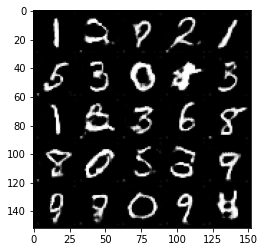

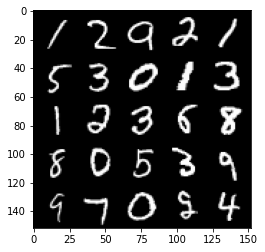

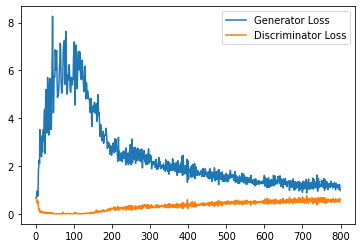

Step 16500: Generator loss: 1.134257329583168, discriminator loss: 0.555804554104805


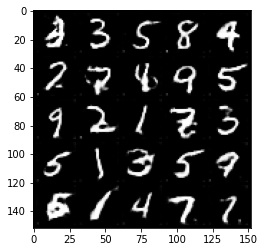

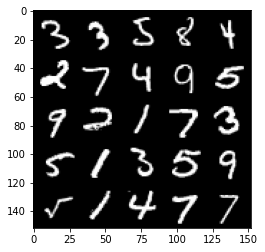

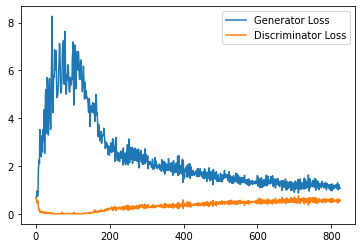

Step 17000: Generator loss: 1.1296315885782242, discriminator loss: 0.5577612711191178


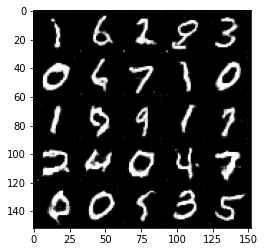

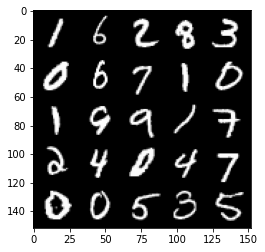

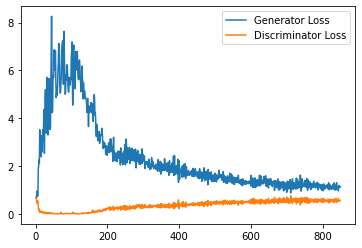

Step 17500: Generator loss: 1.1413199739456177, discriminator loss: 0.5745018967986106


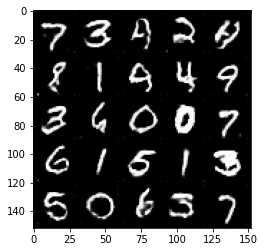

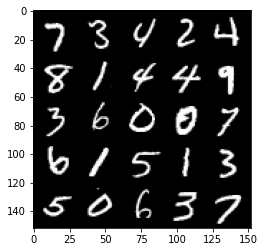

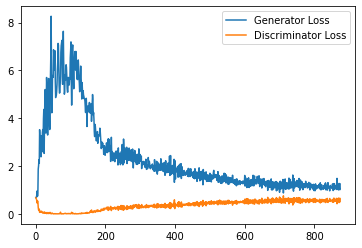

Step 18000: Generator loss: 1.119463873744011, discriminator loss: 0.5616718403100968


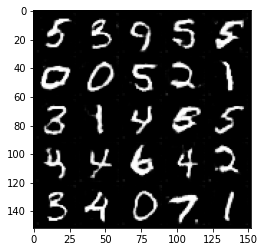

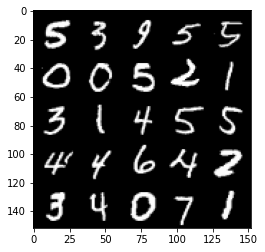

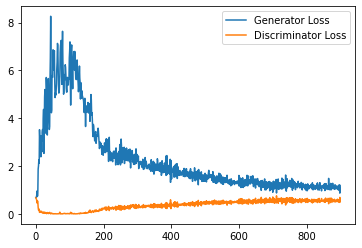

Step 18500: Generator loss: 1.1016453768014909, discriminator loss: 0.5625341213941574


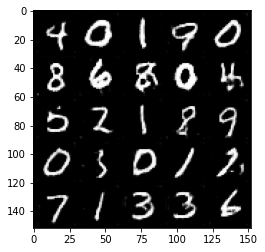

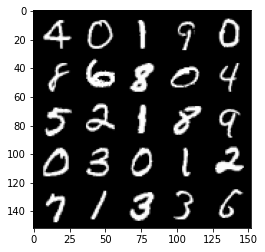

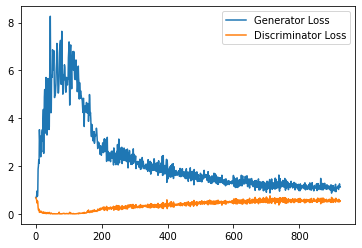

Step 19000: Generator loss: 1.121717859864235, discriminator loss: 0.5716967064738273


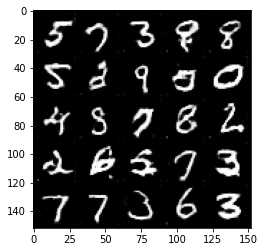

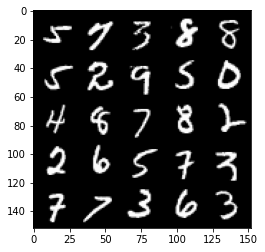

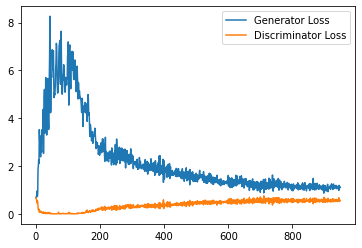

Step 19500: Generator loss: 1.0978456929922105, discriminator loss: 0.5635653722286225


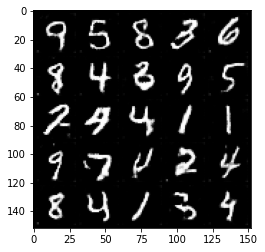

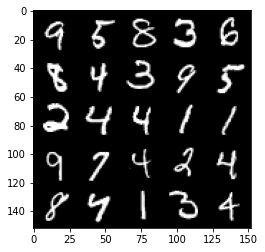

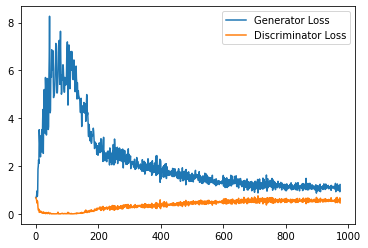

Step 20000: Generator loss: 1.075440276145935, discriminator loss: 0.5770998924970627


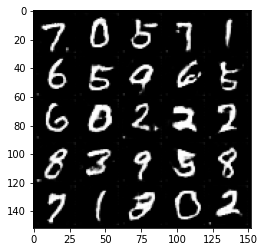

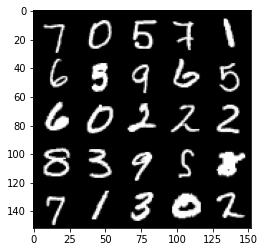

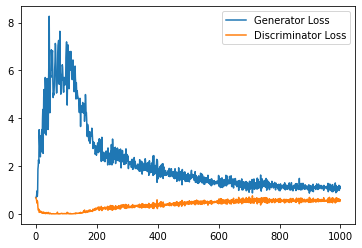

Step 20500: Generator loss: 1.1080071873664856, discriminator loss: 0.571182622551918


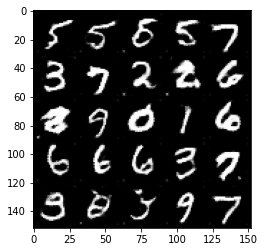

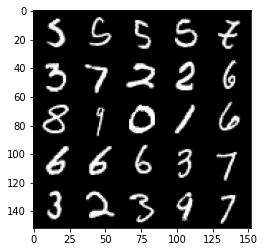

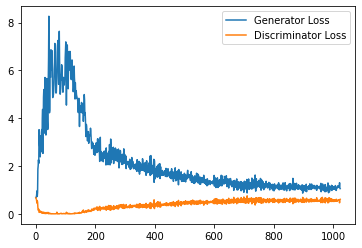

Step 21000: Generator loss: 1.1059207261800765, discriminator loss: 0.5714882759451866


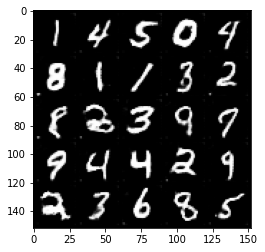

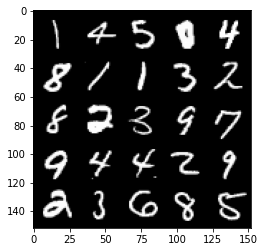

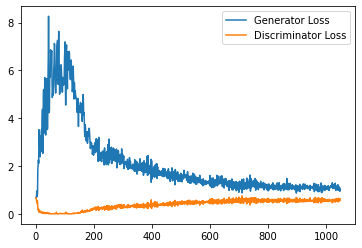

Step 21500: Generator loss: 1.0469318764209747, discriminator loss: 0.5740218875408173


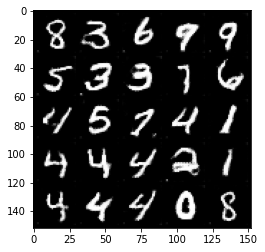

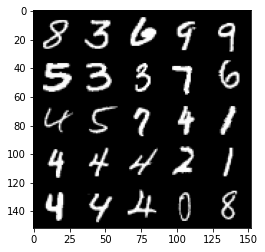

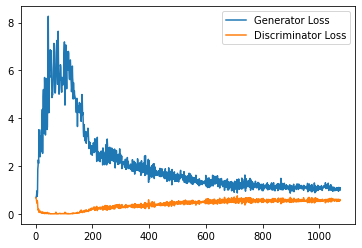

Step 22000: Generator loss: 1.0607105849981309, discriminator loss: 0.5741256480813026


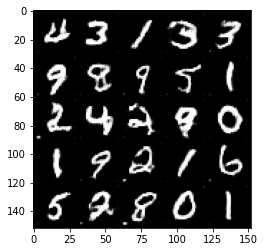

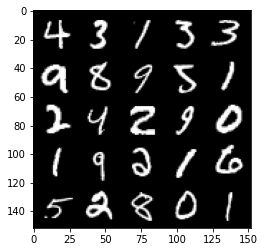

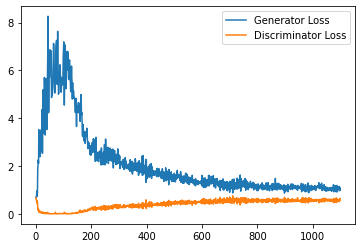

Step 22500: Generator loss: 1.048652821302414, discriminator loss: 0.5811838371157646


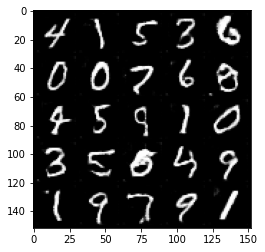

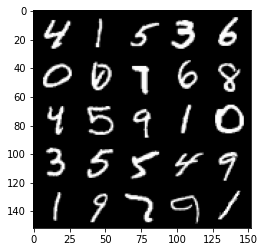

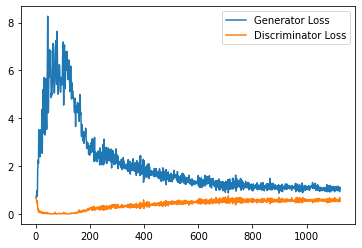

Step 23000: Generator loss: 1.0402456866502763, discriminator loss: 0.5888303534984589


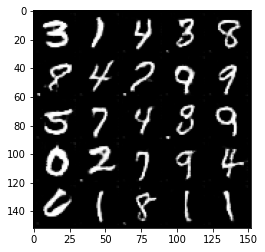

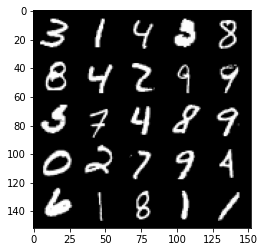

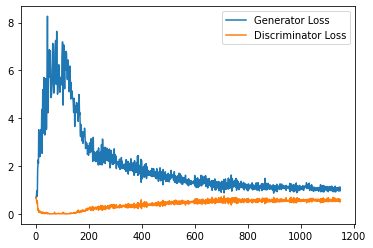

Step 23500: Generator loss: 1.0433012286424637, discriminator loss: 0.5922006205916405


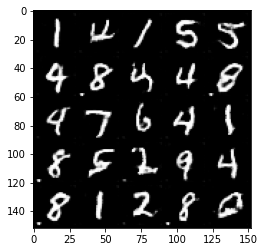

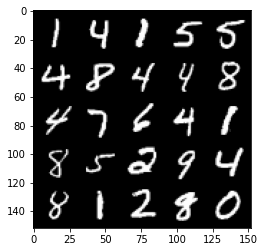

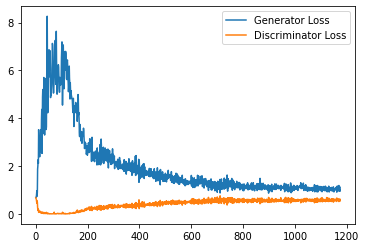

Step 24000: Generator loss: 1.0240160658359527, discriminator loss: 0.5901136334538459


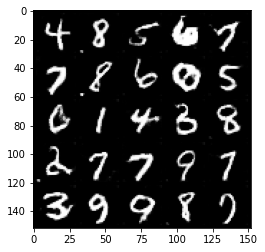

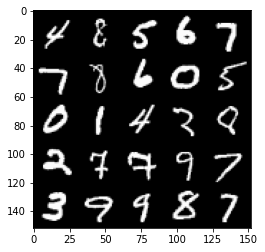

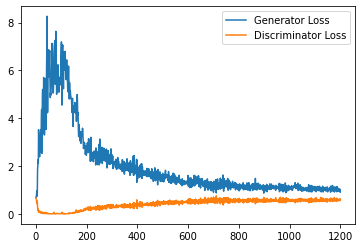

Step 24500: Generator loss: 1.0316494113206864, discriminator loss: 0.5877062395811081


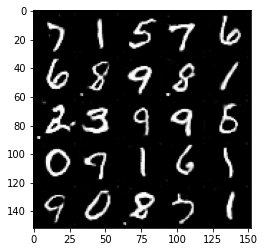

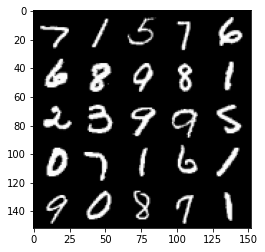

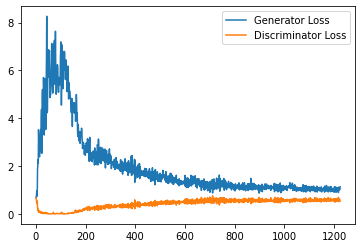

Step 25000: Generator loss: 1.0434812148809434, discriminator loss: 0.593855867266655


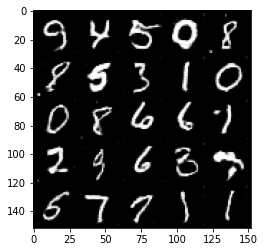

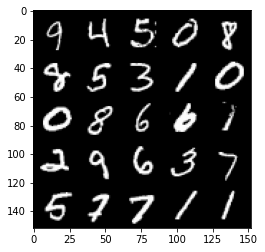

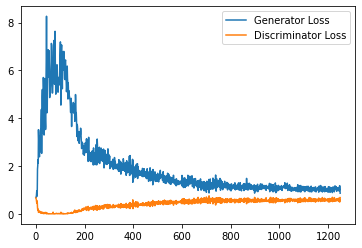

Step 25500: Generator loss: 1.0420085600614548, discriminator loss: 0.5882329096198082


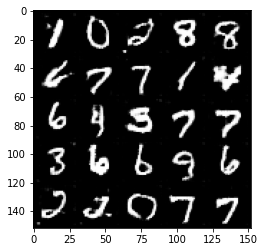

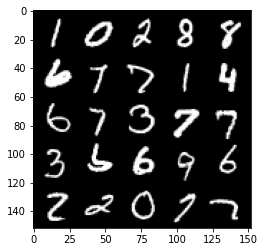

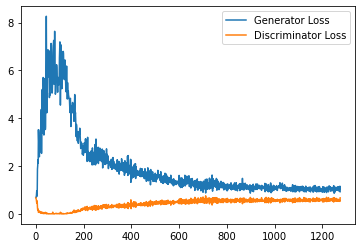

Step 26000: Generator loss: 1.0546468238830566, discriminator loss: 0.5923857005238533


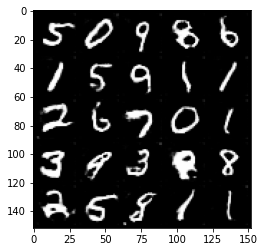

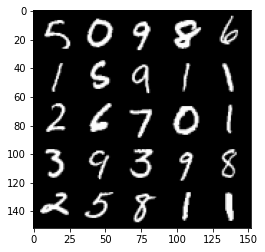

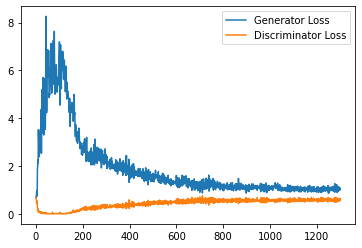

Step 26500: Generator loss: 1.0296187340021132, discriminator loss: 0.595981841981411


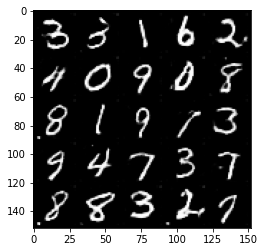

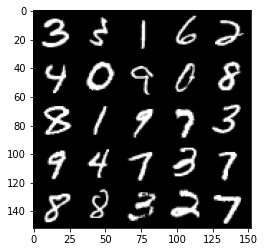

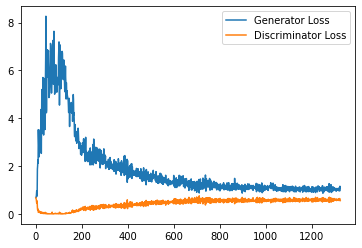

Step 27000: Generator loss: 1.0101262286901473, discriminator loss: 0.5938668230175972


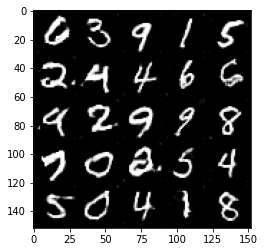

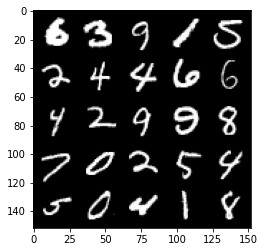

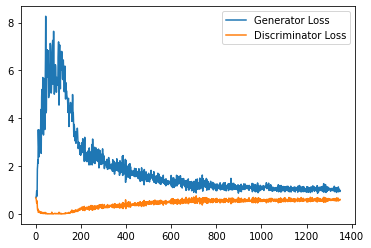

Step 27500: Generator loss: 1.0288216444253921, discriminator loss: 0.5892691100239754


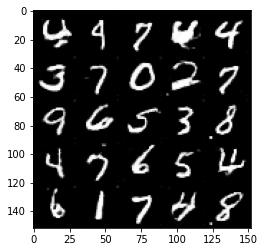

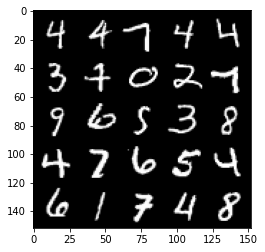

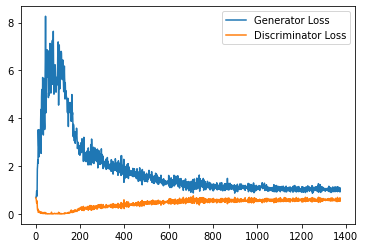

Step 28000: Generator loss: 1.0036084905862808, discriminator loss: 0.5995360224246978


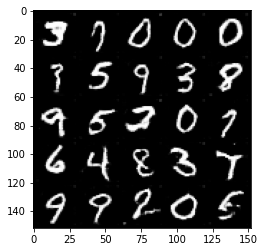

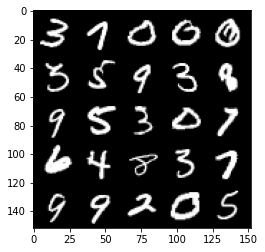

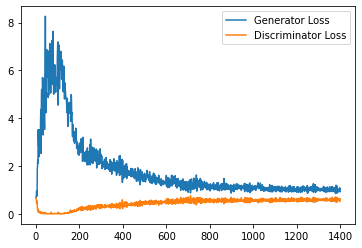

Step 28500: Generator loss: 1.0264635467529297, discriminator loss: 0.6033291064500809


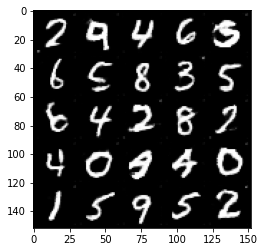

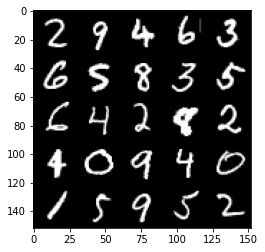

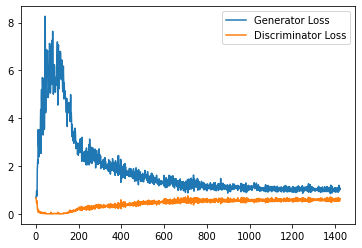

Step 29000: Generator loss: 1.0166858921051025, discriminator loss: 0.6016719917058945


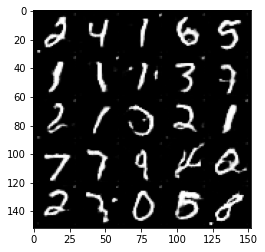

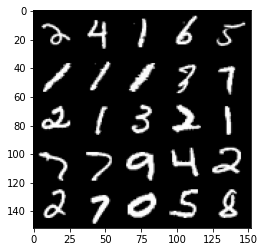

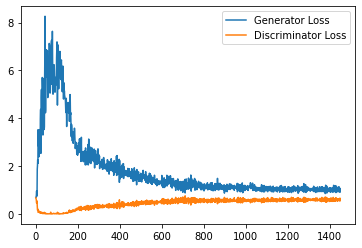

Step 29500: Generator loss: 0.9988637892007828, discriminator loss: 0.6000750453472138


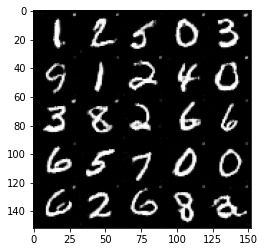

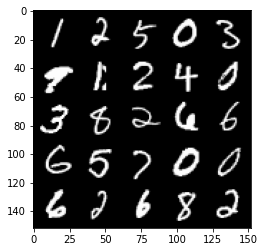

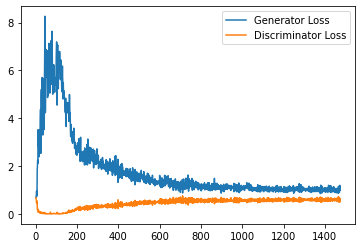

Step 30000: Generator loss: 1.0150681583881378, discriminator loss: 0.5989105396270752


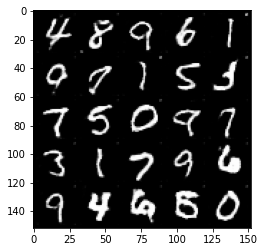

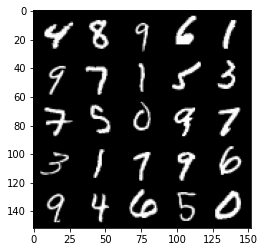

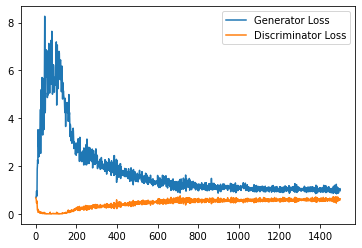

Step 30500: Generator loss: 0.9814849311113357, discriminator loss: 0.6009359885454177


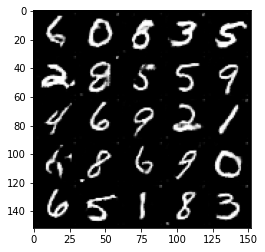

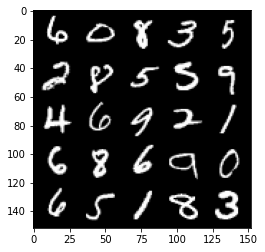

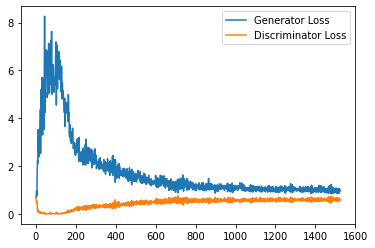

Step 31000: Generator loss: 1.0189489959478377, discriminator loss: 0.5936197672486305


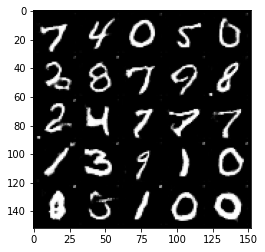

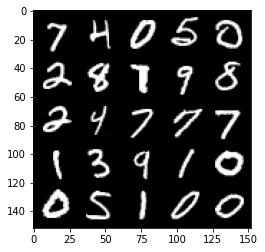

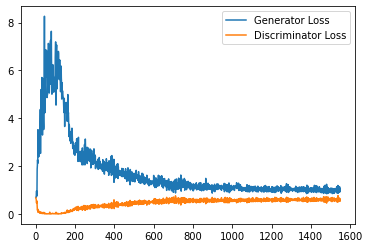

Step 31500: Generator loss: 1.0007256449460984, discriminator loss: 0.5999729802012443


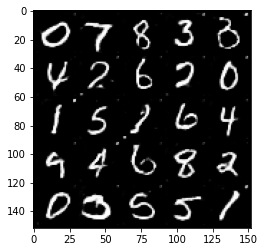

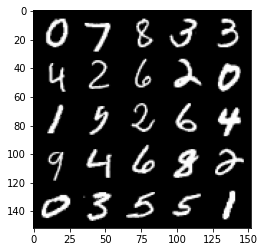

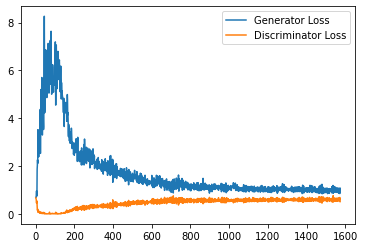

Step 32000: Generator loss: 0.9853364288806915, discriminator loss: 0.6016674812436104


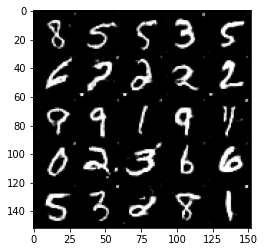

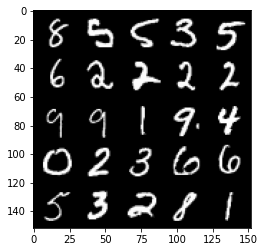

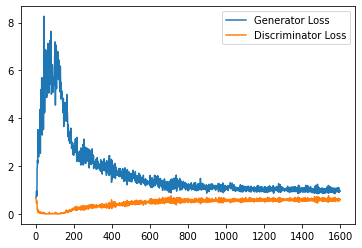

Step 32500: Generator loss: 0.9804434064626694, discriminator loss: 0.5996894005537033


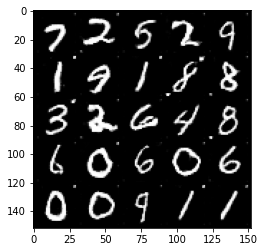

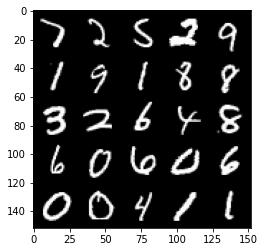

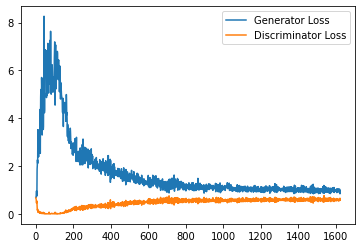

Step 33000: Generator loss: 0.9932972714900971, discriminator loss: 0.6045856403708458


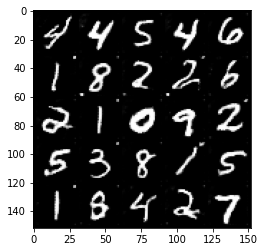

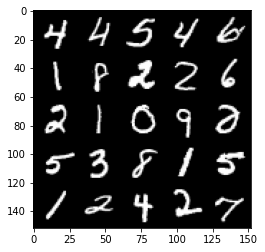

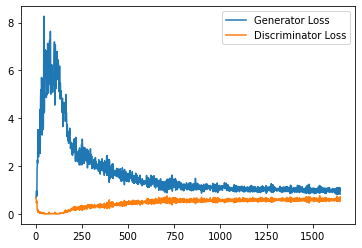

Step 33500: Generator loss: 0.9791127433776855, discriminator loss: 0.6000708354115486


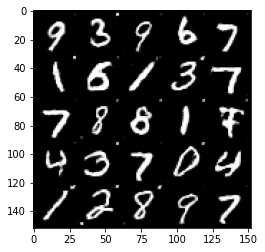

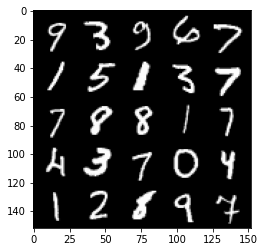

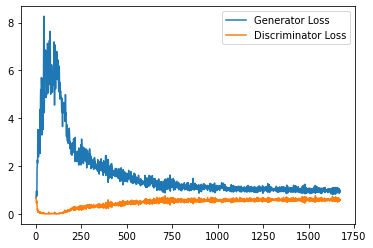

Step 34000: Generator loss: 0.9790617834329605, discriminator loss: 0.6028174948692322


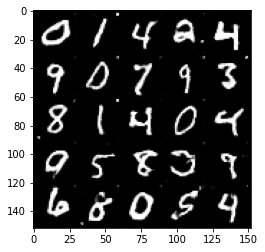

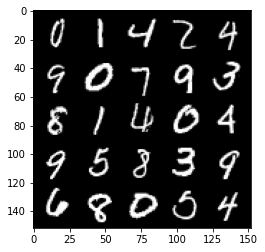

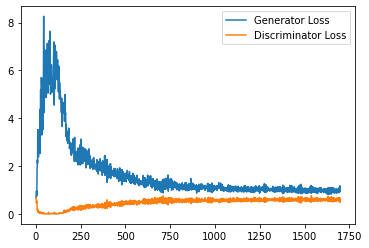

Step 34500: Generator loss: 0.9881361229419708, discriminator loss: 0.6051922944188118


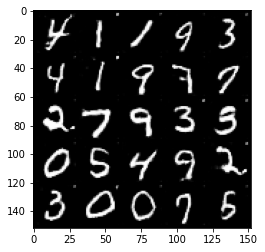

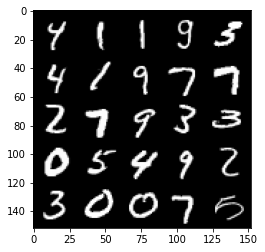

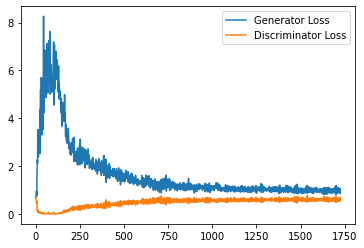

Step 35000: Generator loss: 0.969475191116333, discriminator loss: 0.6070177574157715


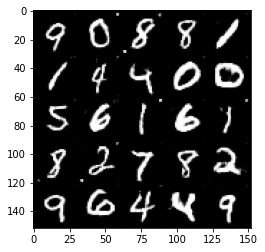

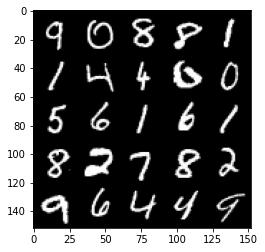

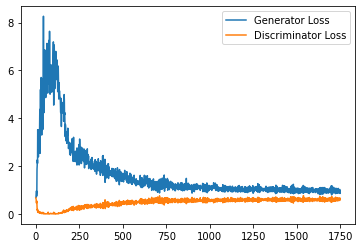

Step 35500: Generator loss: 1.0023962829113007, discriminator loss: 0.6065761886239052


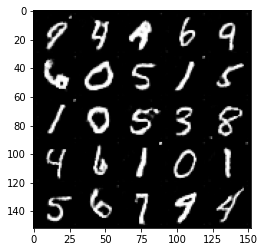

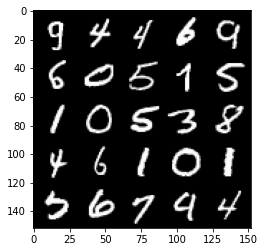

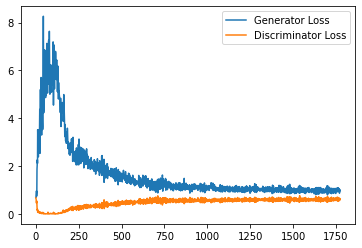

Step 36000: Generator loss: 0.9766369498968125, discriminator loss: 0.6041282525062561


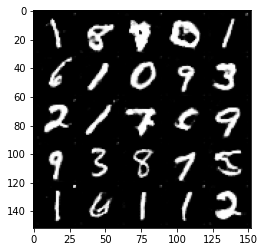

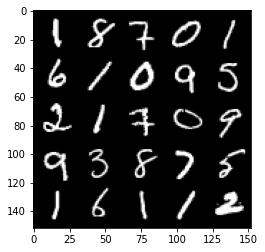

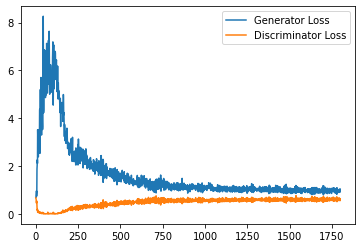

Step 36500: Generator loss: 1.002011675953865, discriminator loss: 0.5960810851454735


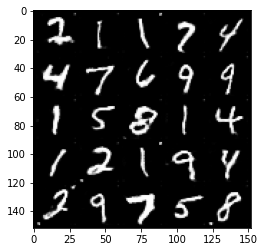

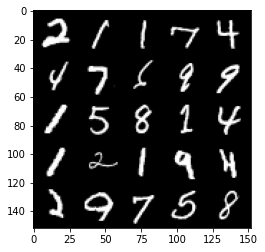

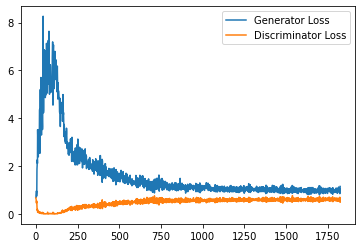

Step 37000: Generator loss: 0.9752314257621765, discriminator loss: 0.6023231444358825


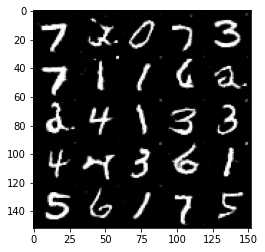

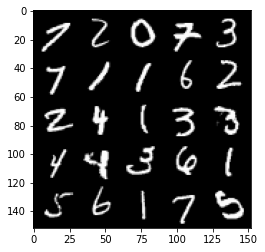

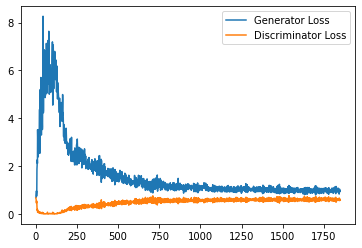

Step 37500: Generator loss: 0.9637938624620438, discriminator loss: 0.6005329279899597


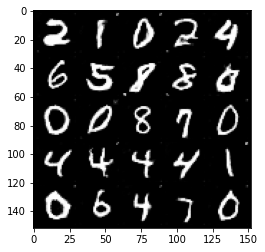

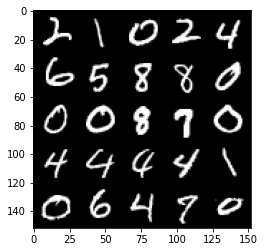

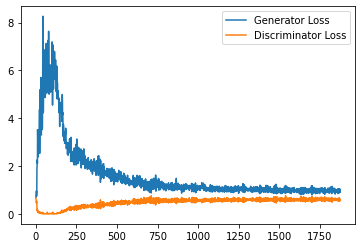

Step 38000: Generator loss: 0.9866136547327041, discriminator loss: 0.5972627542614937


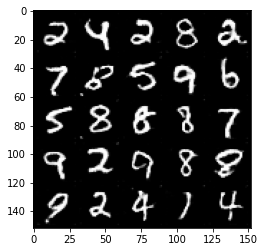

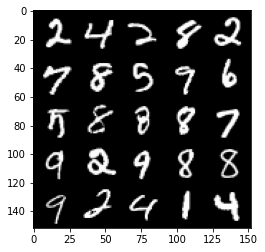

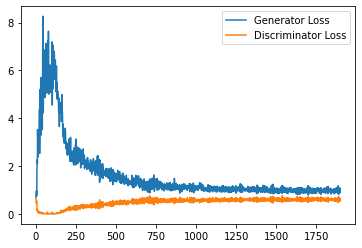

Step 38500: Generator loss: 0.9821660157442093, discriminator loss: 0.600618580698967


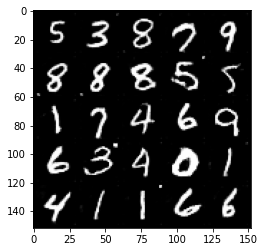

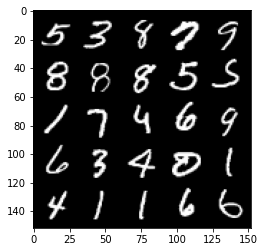

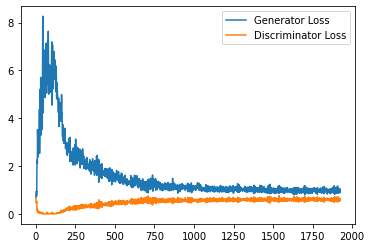

Step 39000: Generator loss: 0.9770129710435868, discriminator loss: 0.5931378030180932


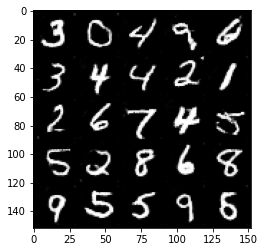

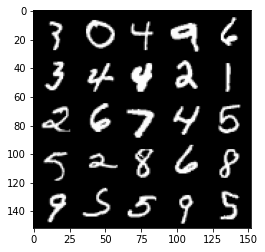

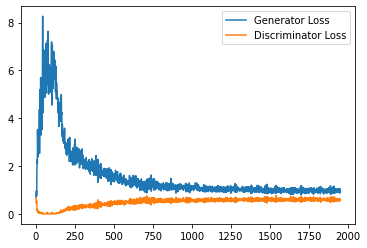

Step 39500: Generator loss: 0.9836608403921128, discriminator loss: 0.5957963621616363


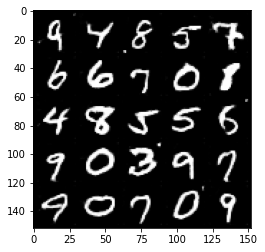

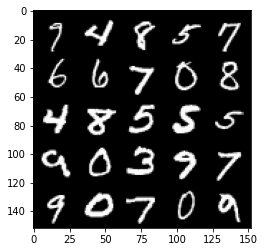

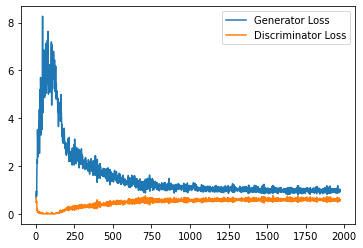

Step 40000: Generator loss: 0.9875228632688522, discriminator loss: 0.5944266654253006


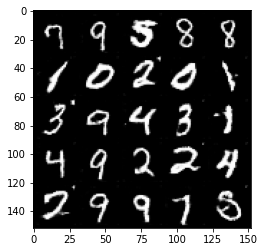

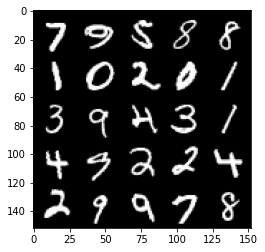

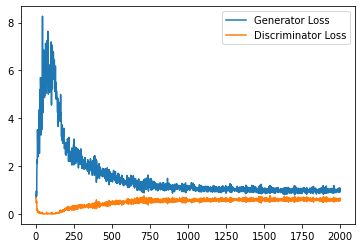

Step 40500: Generator loss: 1.0218207846879959, discriminator loss: 0.5985817440152168


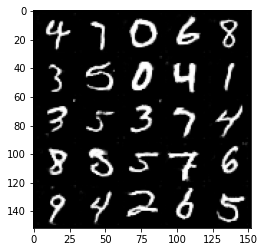

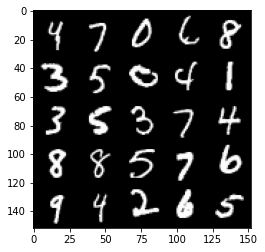

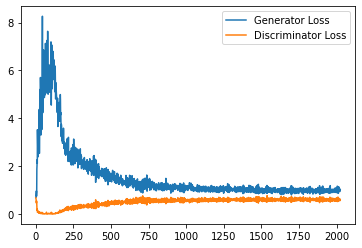

Step 41000: Generator loss: 1.0072426756620407, discriminator loss: 0.5953418607711792


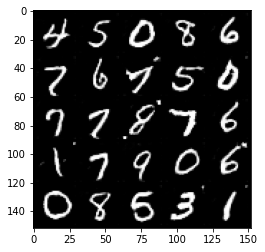

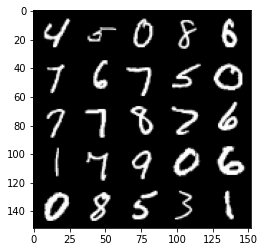

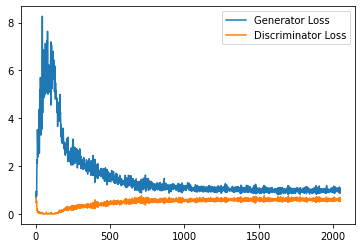

Step 41500: Generator loss: 0.9964206556081772, discriminator loss: 0.5938237622380257


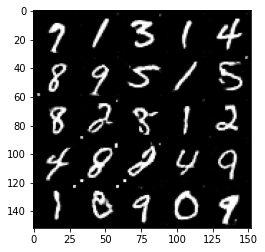

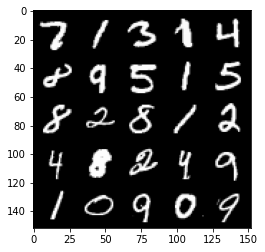

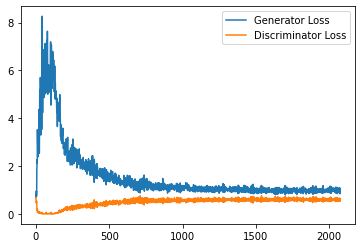

Step 42000: Generator loss: 0.982029321193695, discriminator loss: 0.5918284678459167


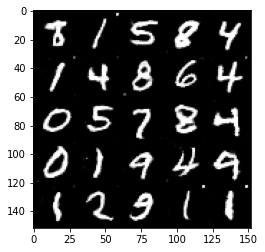

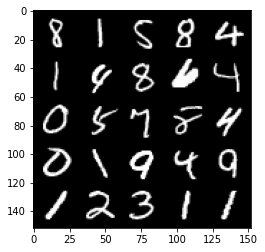

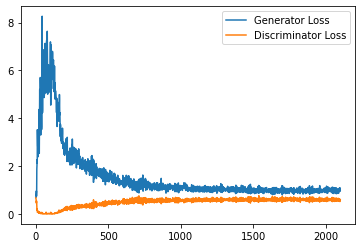

Step 42500: Generator loss: 1.0179472759962083, discriminator loss: 0.5933453624844551


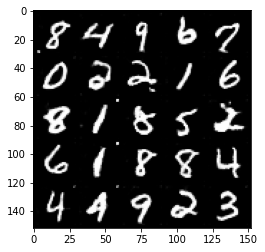

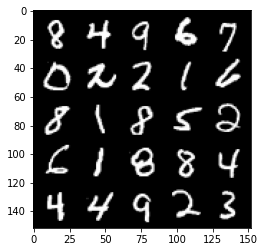

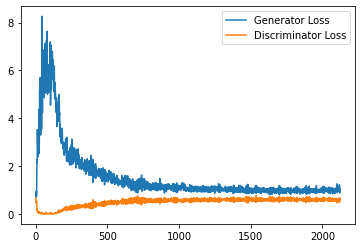

Step 43000: Generator loss: 0.9923909087181091, discriminator loss: 0.5964944632053375


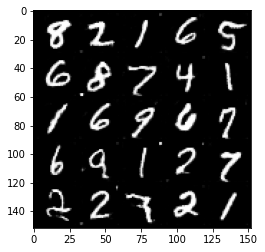

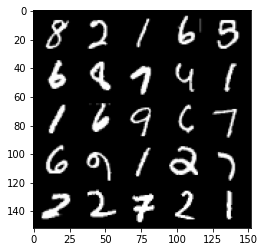

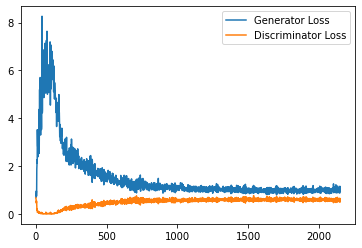

Step 43500: Generator loss: 0.9898275233507157, discriminator loss: 0.593024572789669


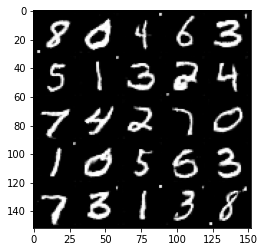

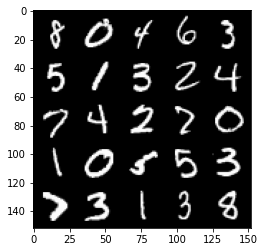

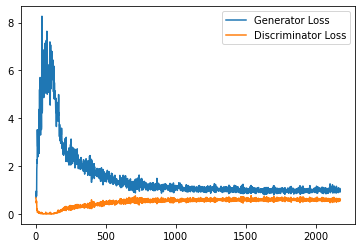

Step 44000: Generator loss: 1.0045233741998671, discriminator loss: 0.5911088339686393


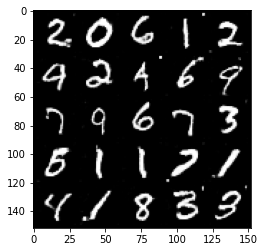

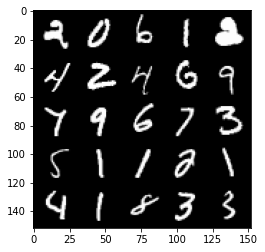

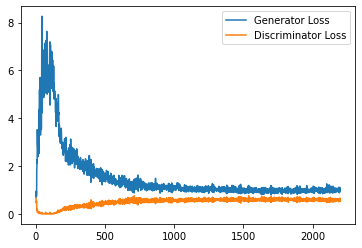

Step 44500: Generator loss: 1.0221479074954987, discriminator loss: 0.5855684332847595


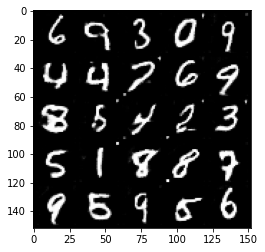

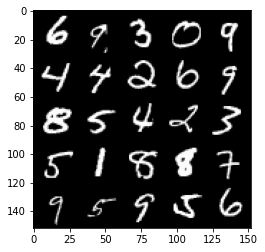

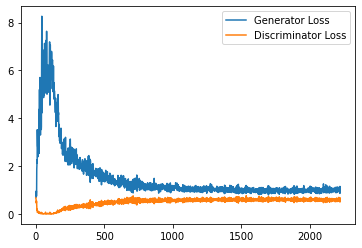

Step 45000: Generator loss: 0.9932796748876571, discriminator loss: 0.5893162191510201


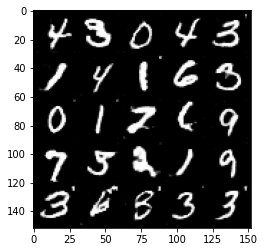

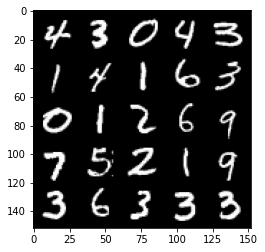

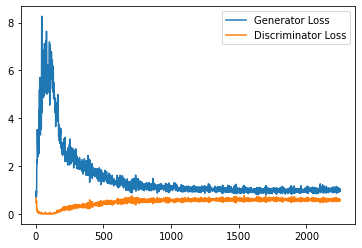

Step 45500: Generator loss: 0.9956681981086731, discriminator loss: 0.5854653305411339


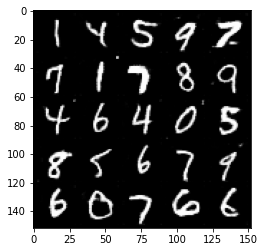

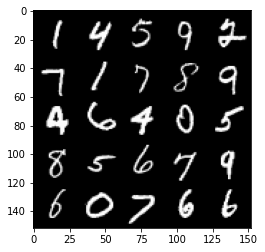

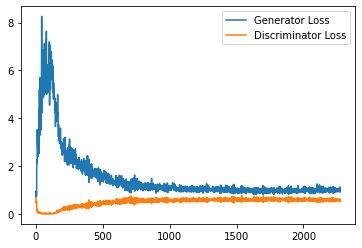

Step 46000: Generator loss: 1.0022584563493728, discriminator loss: 0.5908541967868804


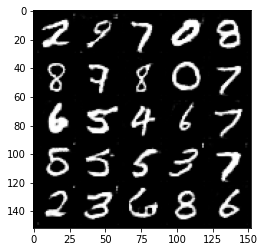

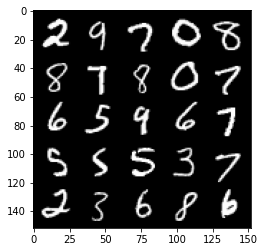

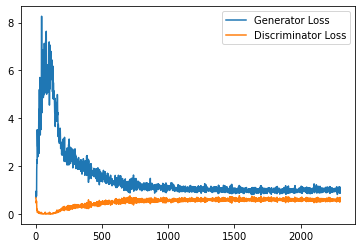

Step 46500: Generator loss: 0.9995576963424683, discriminator loss: 0.5788135946989059


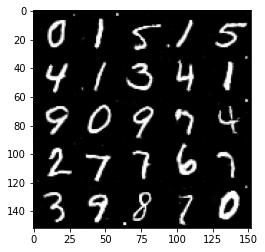

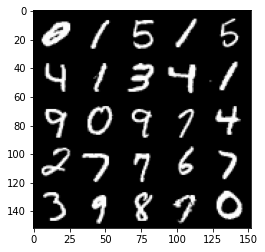

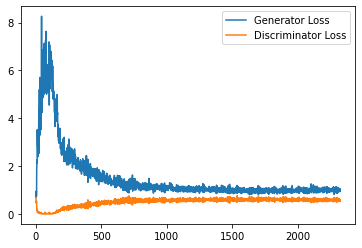

Step 47000: Generator loss: 1.0122520059347153, discriminator loss: 0.5897750883698464


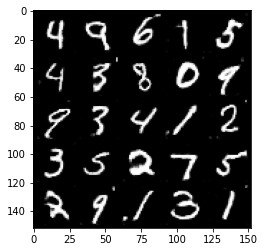

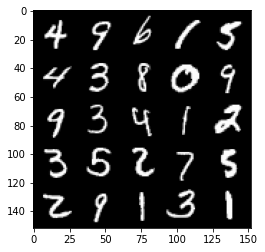

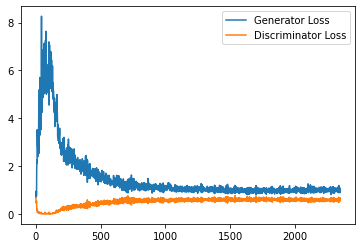

Step 47500: Generator loss: 1.0240042921304702, discriminator loss: 0.5768452675938607


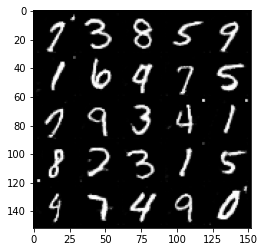

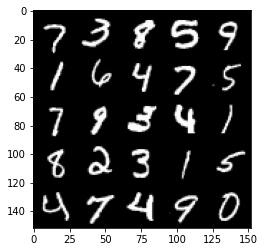

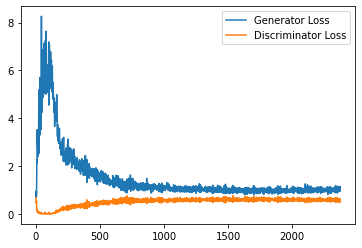

Step 48000: Generator loss: 1.0233123160600661, discriminator loss: 0.5846448375582695


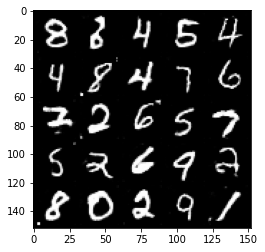

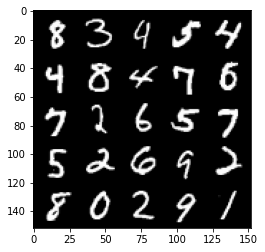

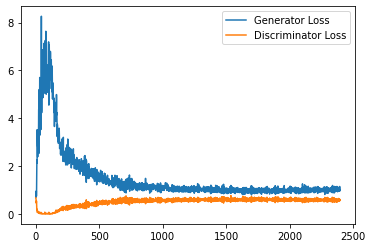

Step 48500: Generator loss: 1.020640141248703, discriminator loss: 0.5798384464383125


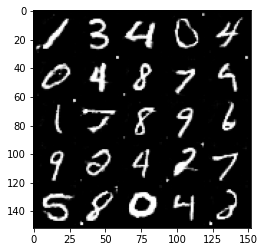

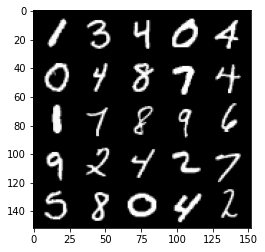

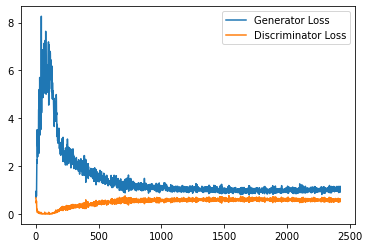

Step 49000: Generator loss: 1.0333336193561553, discriminator loss: 0.579289747595787


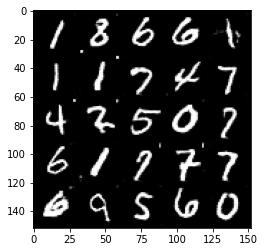

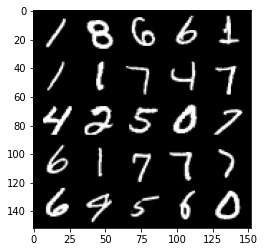

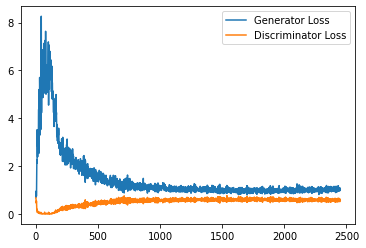

Step 49500: Generator loss: 1.0152105280160904, discriminator loss: 0.5763677306175232


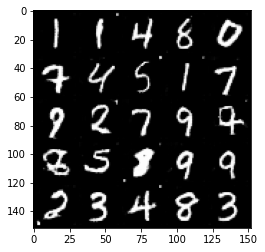

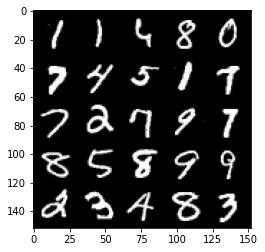

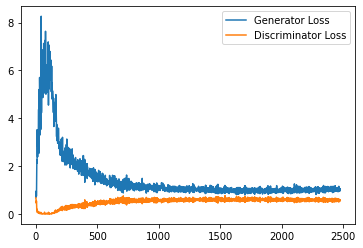

Step 50000: Generator loss: 1.0329381979703902, discriminator loss: 0.5718786729574203


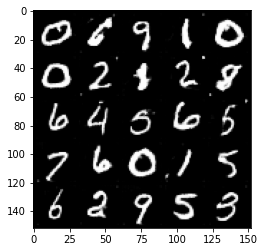

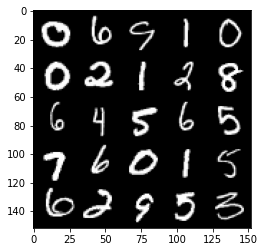

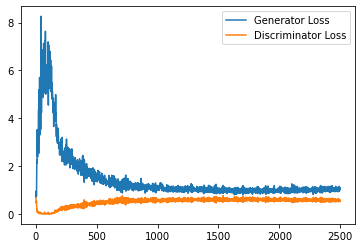

Step 50500: Generator loss: 1.032766534090042, discriminator loss: 0.5784303066134453


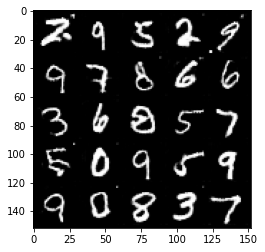

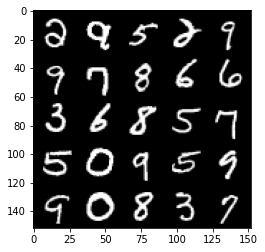

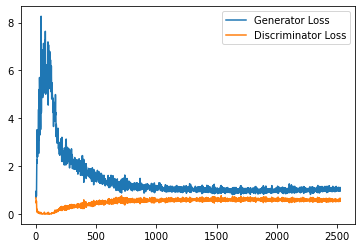

Step 51000: Generator loss: 1.0266884421110154, discriminator loss: 0.5740220175981522


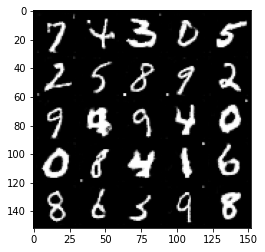

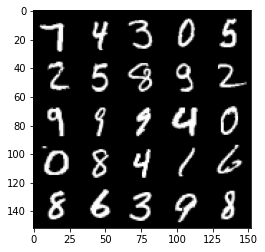

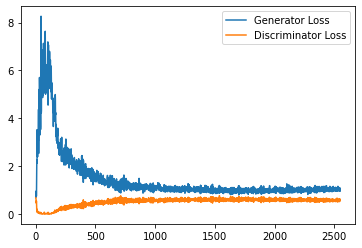

Step 51500: Generator loss: 1.038896730184555, discriminator loss: 0.5774484995007515


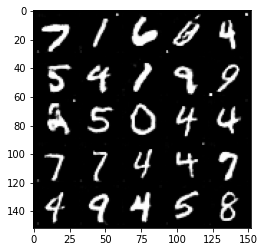

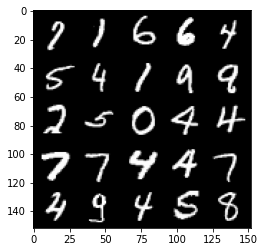

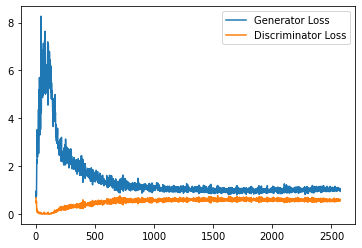

Step 52000: Generator loss: 1.0262037663459778, discriminator loss: 0.574363971054554


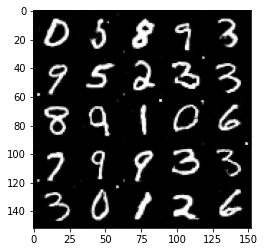

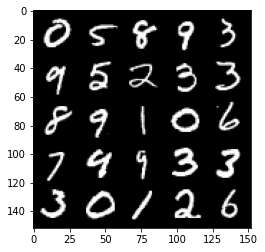

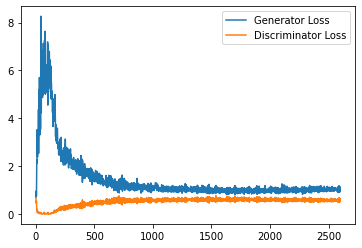

Step 52500: Generator loss: 1.0279002319574355, discriminator loss: 0.5750293620824813


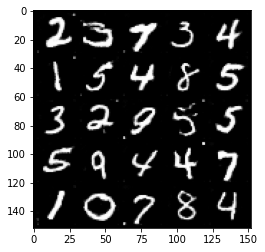

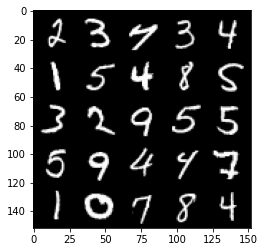

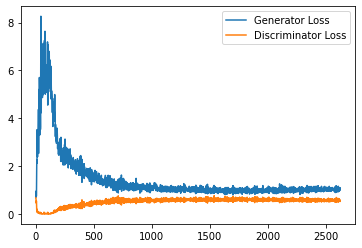

Step 53000: Generator loss: 1.0393018618822099, discriminator loss: 0.5776347303390503


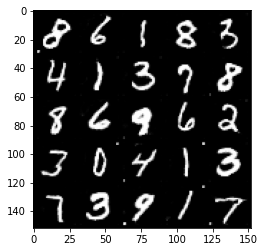

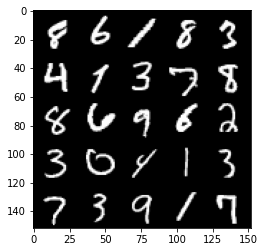

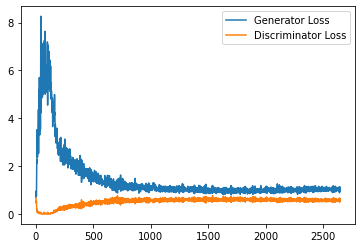

Step 53500: Generator loss: 1.045252903819084, discriminator loss: 0.5708945373892784


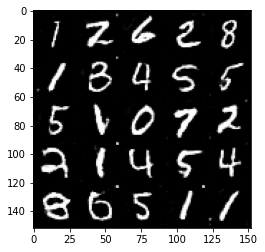

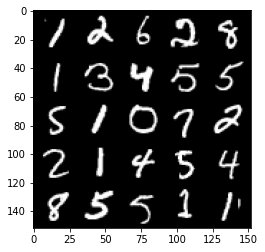

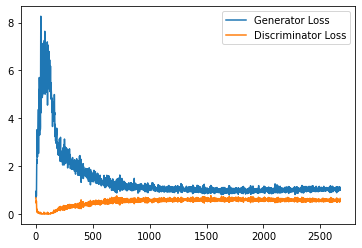

Step 54000: Generator loss: 1.047434545993805, discriminator loss: 0.5707144494056702


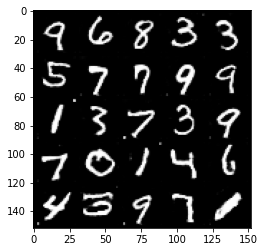

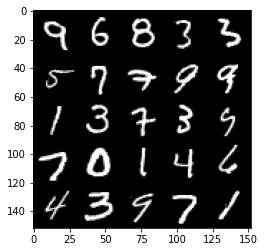

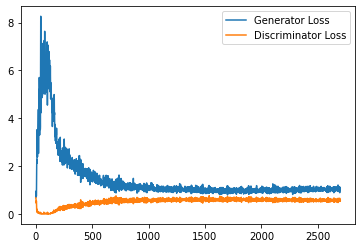

Step 54500: Generator loss: 1.0456834228038787, discriminator loss: 0.5696617588400841


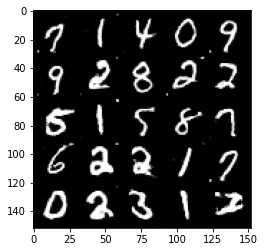

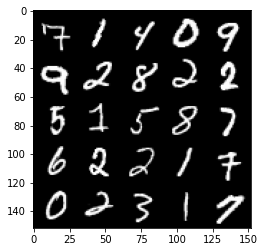

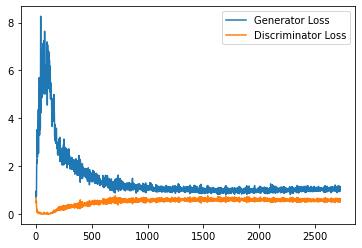

Step 55000: Generator loss: 1.0588097313642502, discriminator loss: 0.5717501773834228


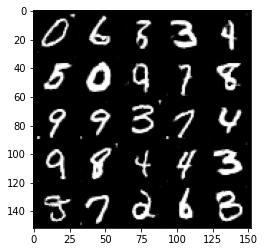

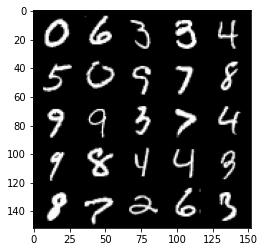

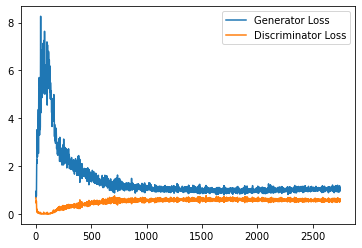

Step 55500: Generator loss: 1.039488844394684, discriminator loss: 0.5673346338272095


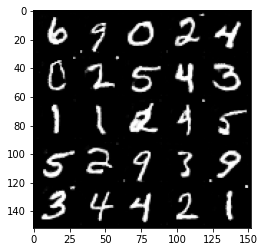

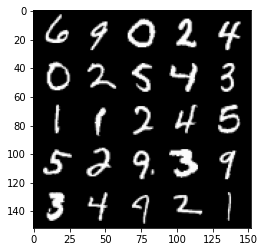

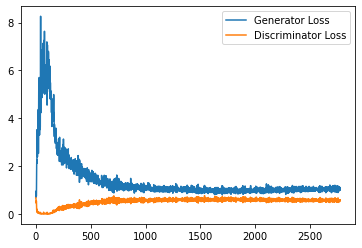

Step 56000: Generator loss: 1.0674450007677079, discriminator loss: 0.5637896485328674


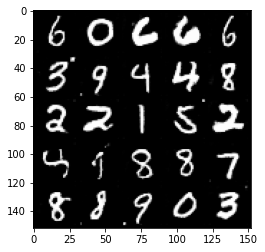

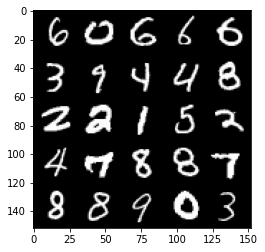

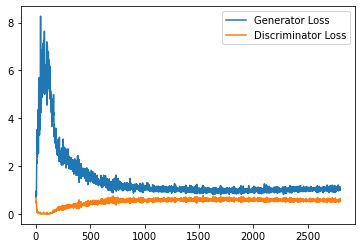

Step 56500: Generator loss: 1.0485580559968948, discriminator loss: 0.5673561760783196


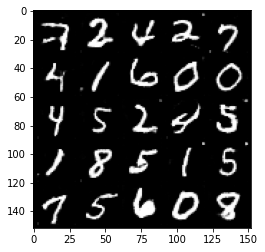

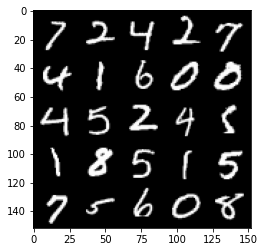

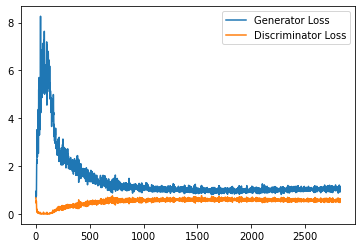

Step 57000: Generator loss: 1.0508205471038818, discriminator loss: 0.5680738863348961


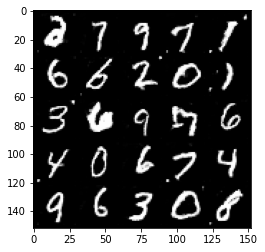

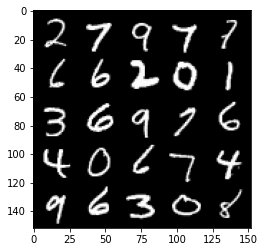

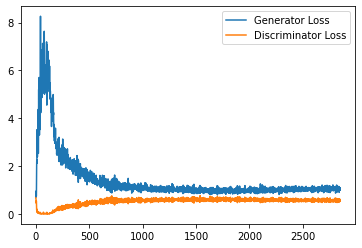

Step 57500: Generator loss: 1.0495262582302094, discriminator loss: 0.562664983868599


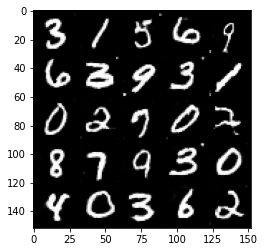

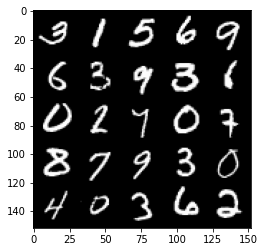

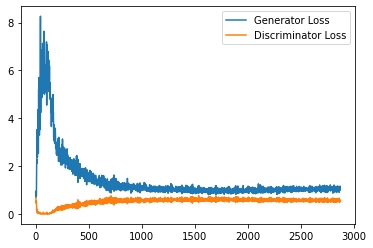

Step 58000: Generator loss: 1.0658676444292068, discriminator loss: 0.5639324534535408


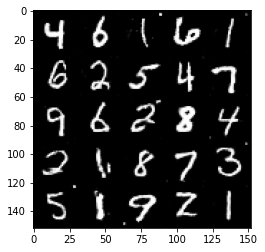

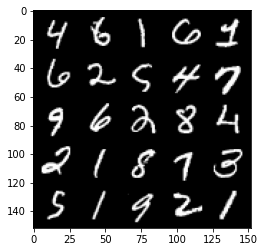

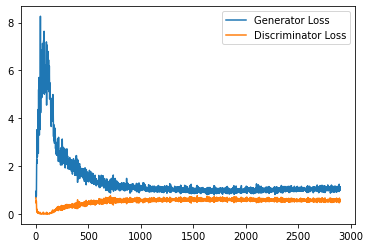

Step 58500: Generator loss: 1.075294966340065, discriminator loss: 0.5654000416398048


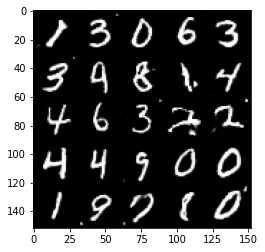

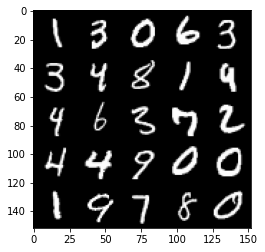

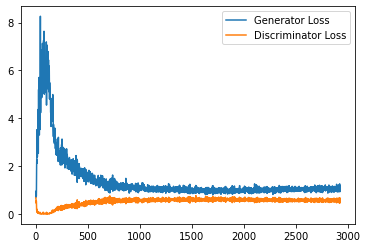

Step 59000: Generator loss: 1.0530153357982635, discriminator loss: 0.5692836524844169


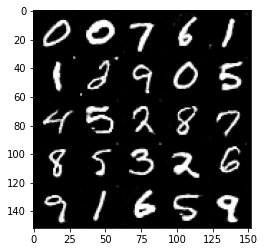

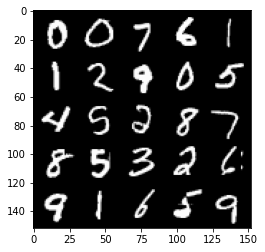

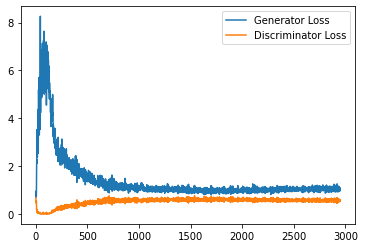

Step 59500: Generator loss: 1.0629890431165696, discriminator loss: 0.5659798379540444


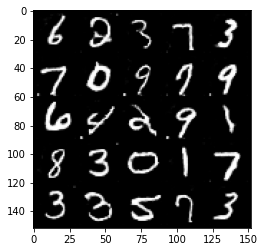

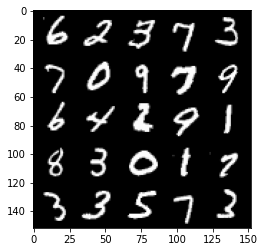

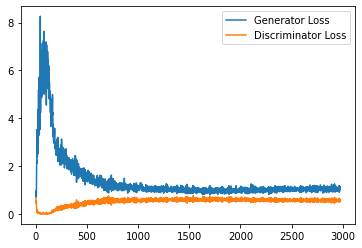

Step 60000: Generator loss: 1.0632339580059051, discriminator loss: 0.5621592515707016


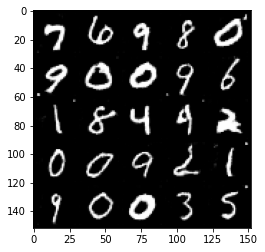

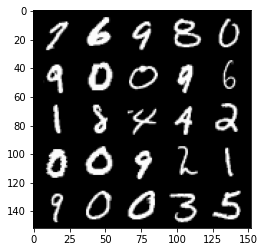

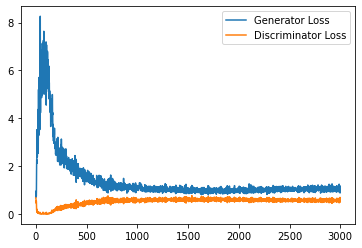

Step 60500: Generator loss: 1.0750573630332947, discriminator loss: 0.562991724550724


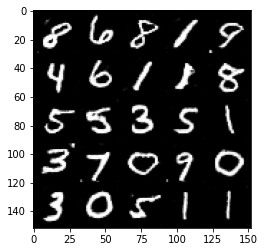

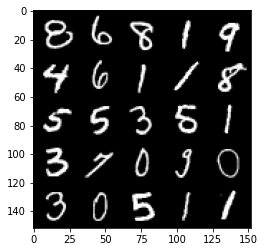

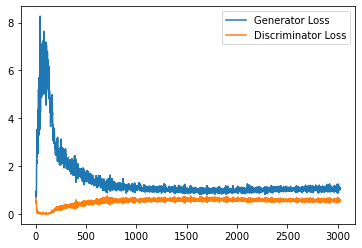

Step 61000: Generator loss: 1.0600623435974121, discriminator loss: 0.5614507250189781


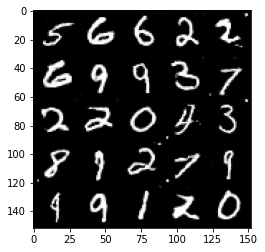

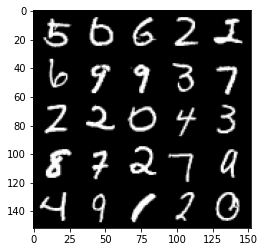

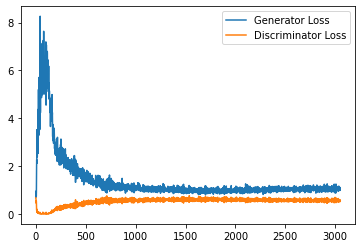

Step 61500: Generator loss: 1.0688584938049317, discriminator loss: 0.5682772749662399


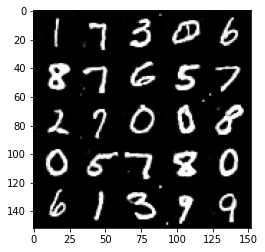

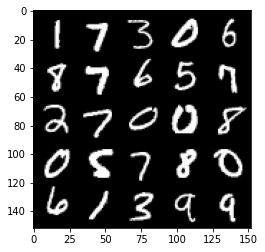

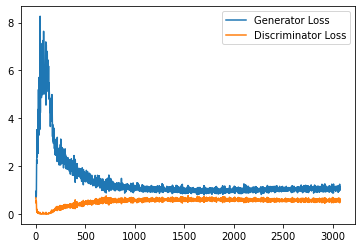

Step 62000: Generator loss: 1.0525706540346145, discriminator loss: 0.5654553681612015


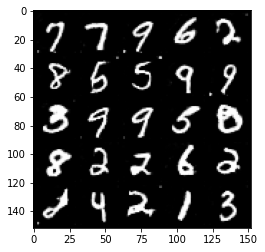

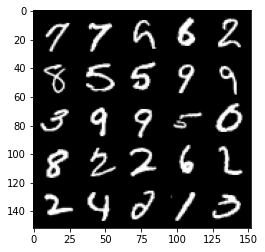

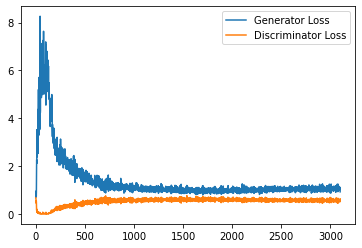

Step 62500: Generator loss: 1.0822112189531325, discriminator loss: 0.5551446287631988


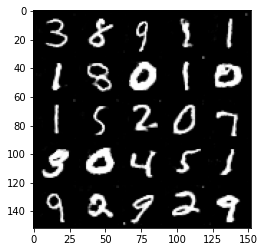

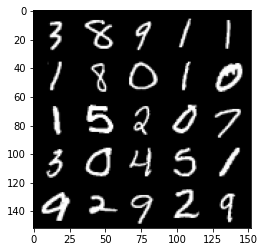

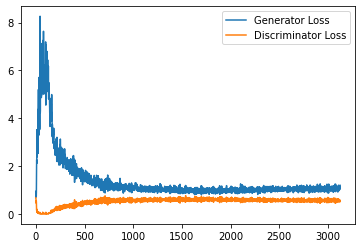

Step 63000: Generator loss: 1.0798881069421769, discriminator loss: 0.5675542150735855


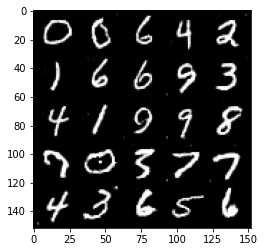

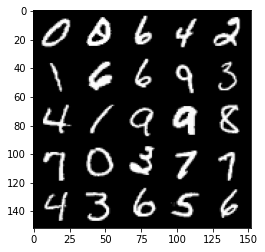

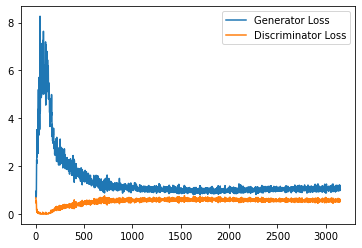

Step 63500: Generator loss: 1.0699491770267486, discriminator loss: 0.5587188280820846


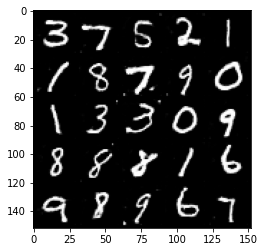

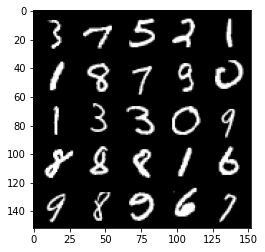

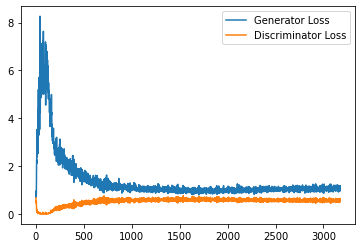

Step 64000: Generator loss: 1.0762033437490464, discriminator loss: 0.5626049616932869


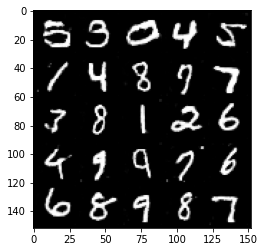

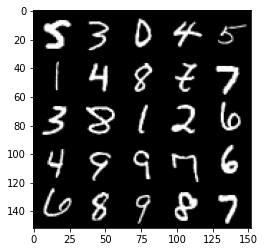

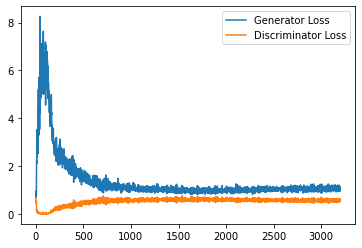

Step 64500: Generator loss: 1.0964929534196854, discriminator loss: 0.5581174041628838


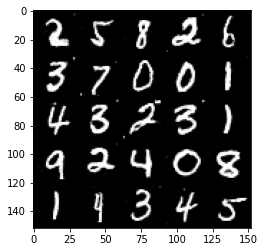

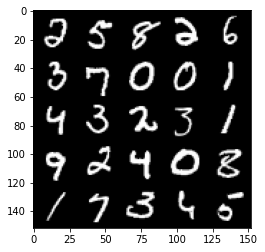

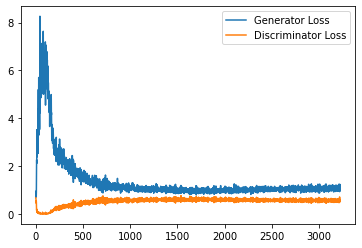

Step 65000: Generator loss: 1.0782153805494308, discriminator loss: 0.5612326179742813


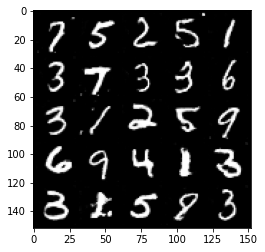

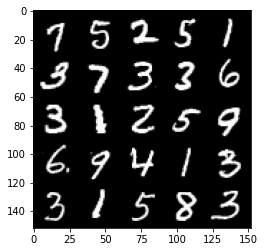

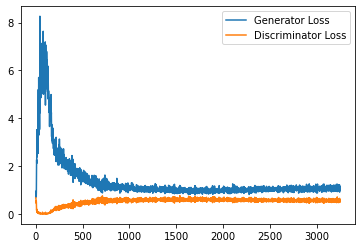

Step 65500: Generator loss: 1.0772108385562897, discriminator loss: 0.5612648895382881


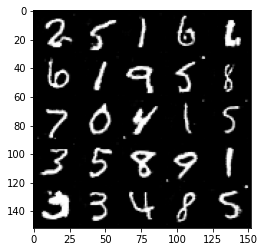

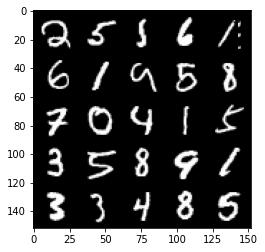

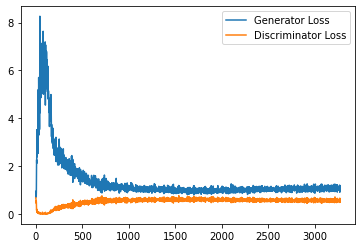

Step 66000: Generator loss: 1.0791934357881545, discriminator loss: 0.5563771987557411


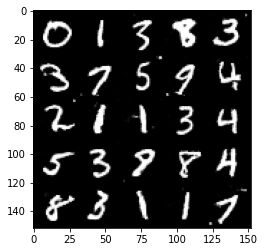

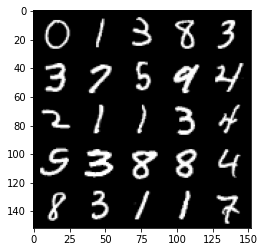

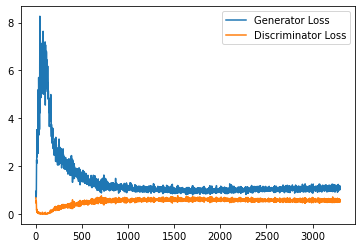

Step 66500: Generator loss: 1.1012143257856368, discriminator loss: 0.5625332101583481


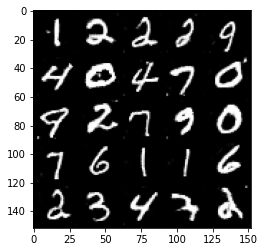

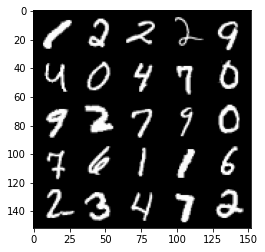

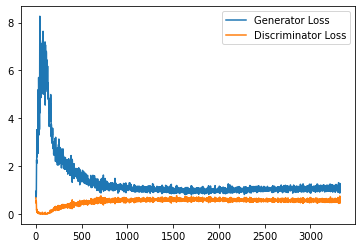

Step 67000: Generator loss: 1.0810721675157546, discriminator loss: 0.5615572548508644


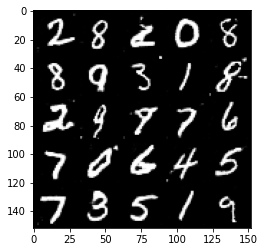

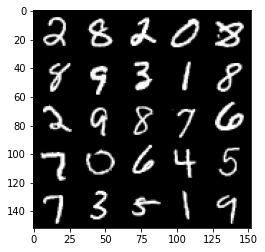

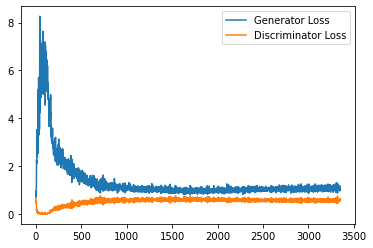

Step 67500: Generator loss: 1.0844948202371598, discriminator loss: 0.5498014062643051


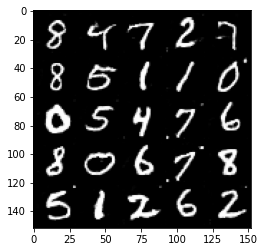

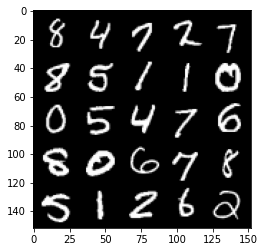

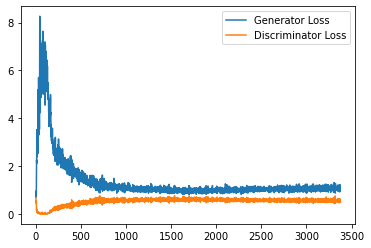

Step 68000: Generator loss: 1.0714611675739287, discriminator loss: 0.565667768418789


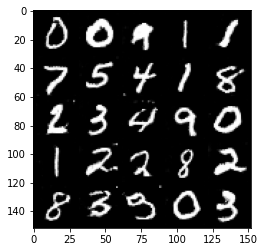

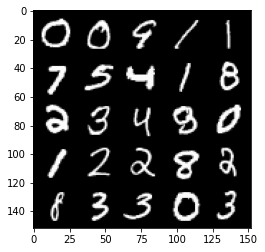

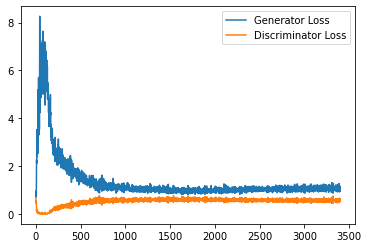

Step 68500: Generator loss: 1.111791416168213, discriminator loss: 0.5539456467032433


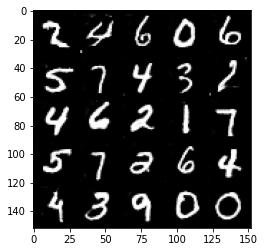

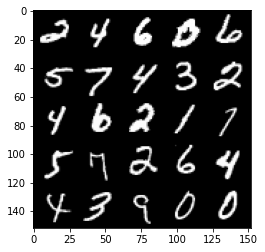

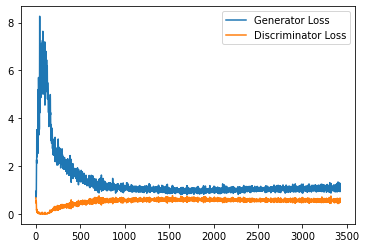

Step 69000: Generator loss: 1.0709198429584503, discriminator loss: 0.5639659243226052


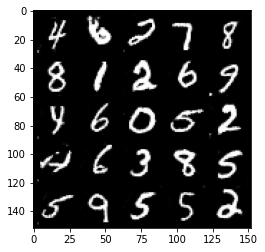

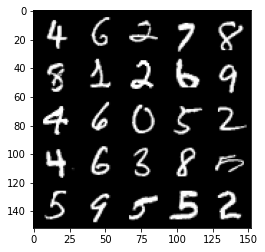

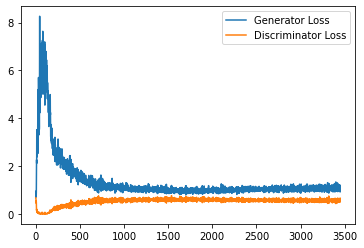

Step 69500: Generator loss: 1.1020573533773421, discriminator loss: 0.5578920127749443


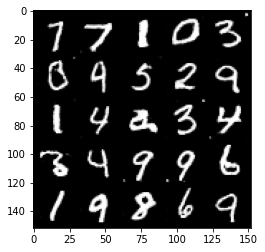

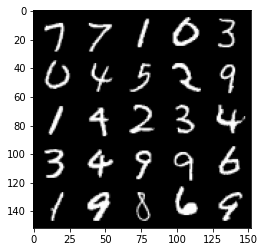

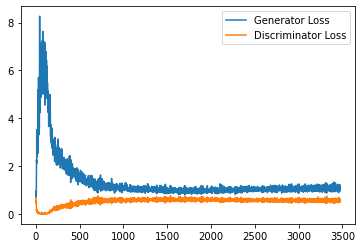

Step 70000: Generator loss: 1.073832511305809, discriminator loss: 0.5606481672525406


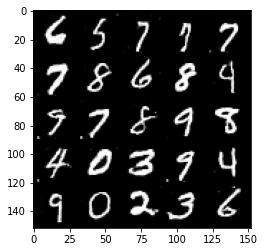

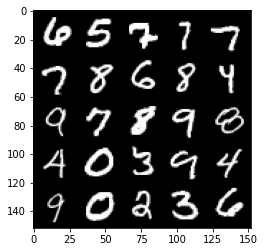

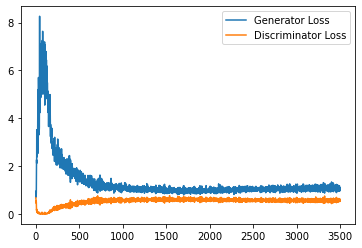

Step 70500: Generator loss: 1.0966830967664718, discriminator loss: 0.5602111997008323


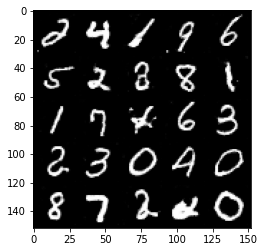

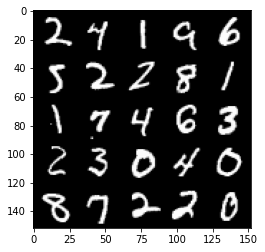

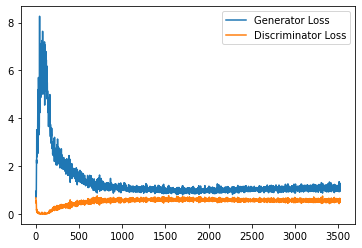

Step 71000: Generator loss: 1.097000769853592, discriminator loss: 0.5603446892499924


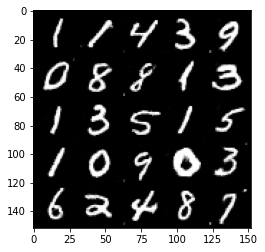

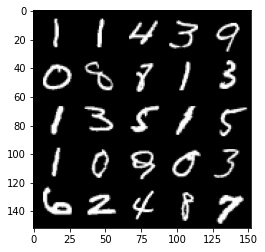

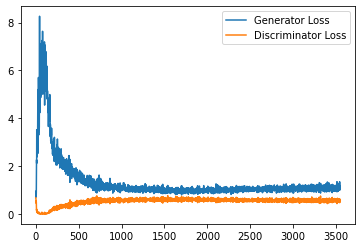

Step 71500: Generator loss: 1.1037215162515641, discriminator loss: 0.5562671256065369


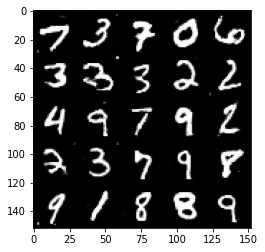

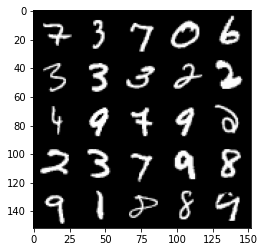

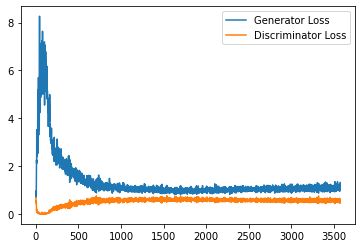

Step 72000: Generator loss: 1.1015451047420501, discriminator loss: 0.560214033305645


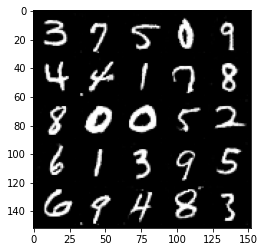

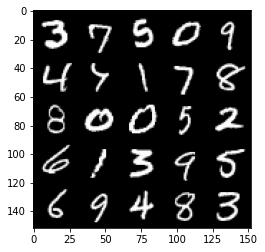

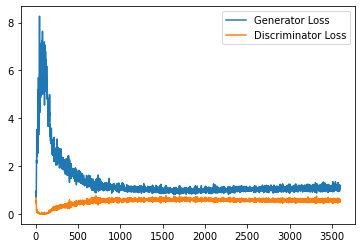

Step 72500: Generator loss: 1.0957671196460723, discriminator loss: 0.553764260172844


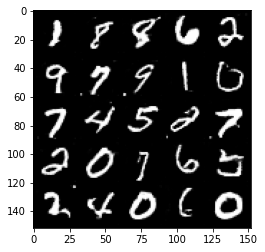

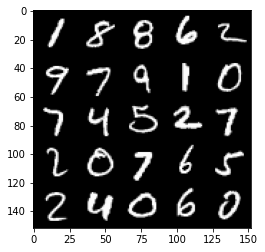

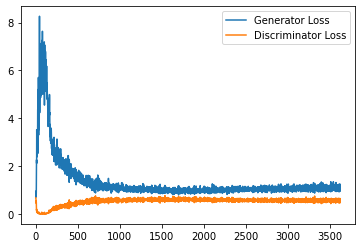

Step 73000: Generator loss: 1.0928888458013535, discriminator loss: 0.5590128324627877


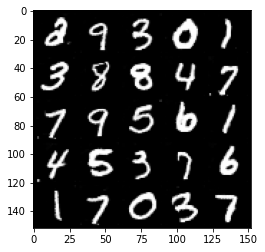

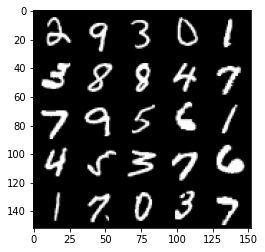

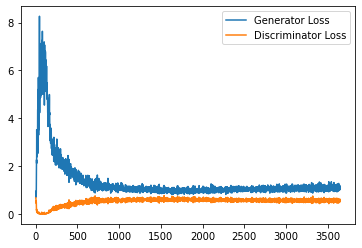

Step 73500: Generator loss: 1.1009266600608825, discriminator loss: 0.5622102085351944


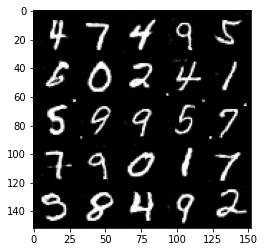

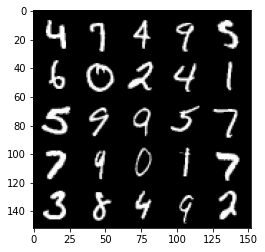

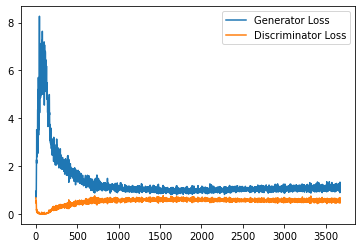

Step 74000: Generator loss: 1.105791328072548, discriminator loss: 0.5597161118984222


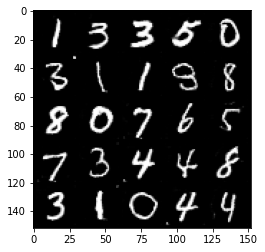

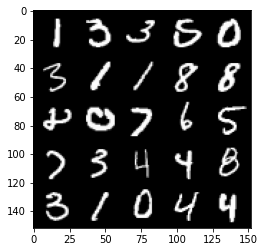

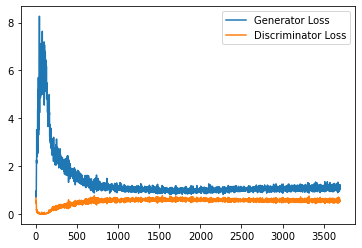

Step 74500: Generator loss: 1.0978738708496094, discriminator loss: 0.5635867921710014


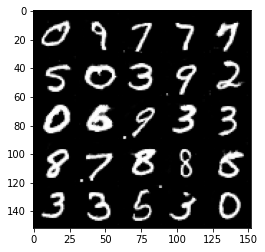

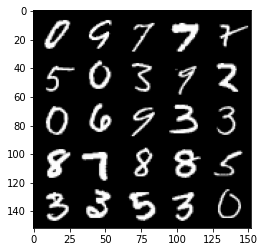

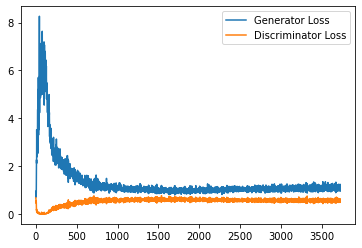

Step 75000: Generator loss: 1.0891914794445037, discriminator loss: 0.5632077323198319


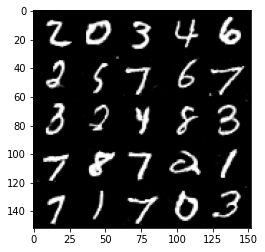

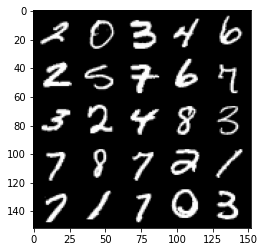

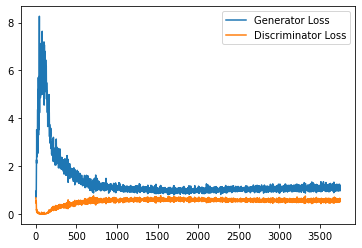

Step 75500: Generator loss: 1.0772675112485885, discriminator loss: 0.5581776109933854


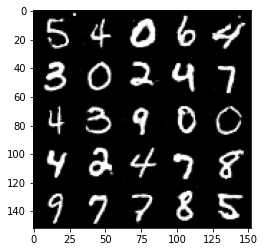

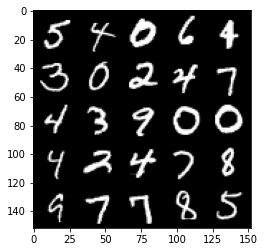

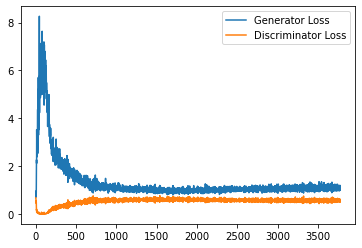

Step 76000: Generator loss: 1.0908545967340468, discriminator loss: 0.5676657506823539


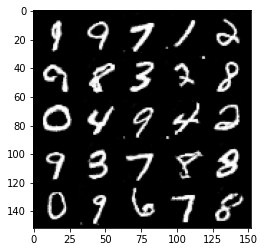

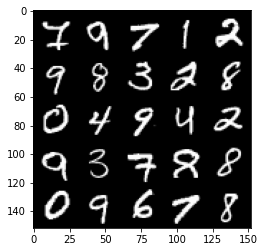

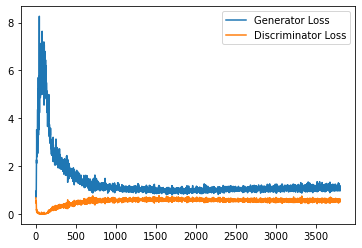

Step 76500: Generator loss: 1.0984357665777207, discriminator loss: 0.561797191798687


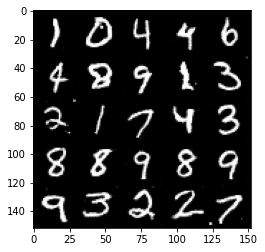

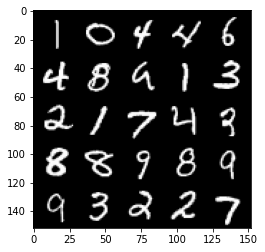

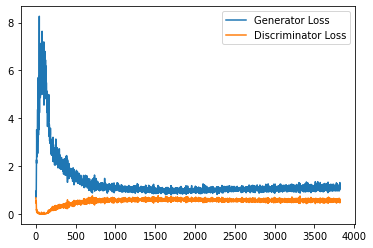

Step 77000: Generator loss: 1.0991362620592118, discriminator loss: 0.5740857492685318


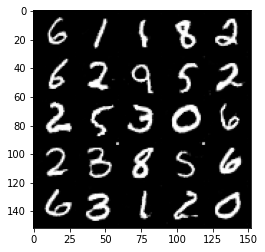

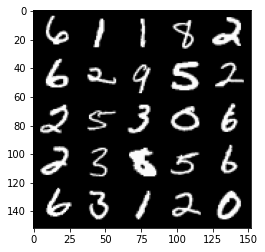

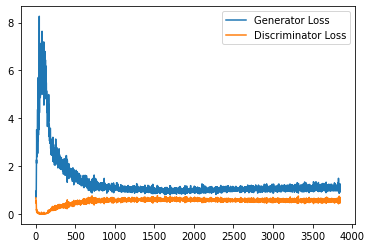

Step 77500: Generator loss: 1.1049011701345444, discriminator loss: 0.5606728274822235


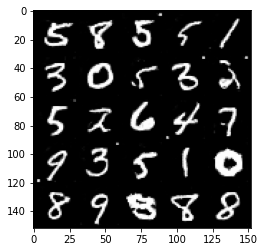

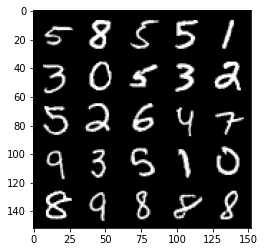

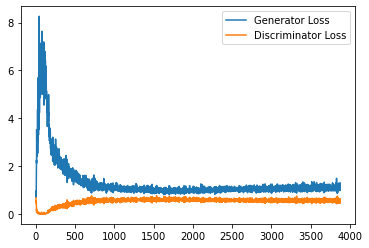

Step 78000: Generator loss: 1.086719144642353, discriminator loss: 0.5640991935729981


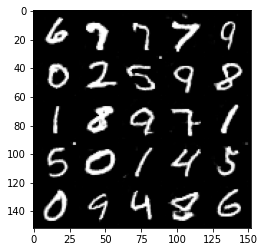

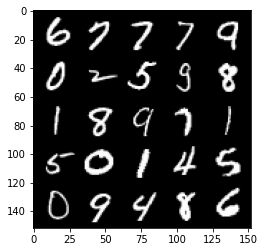

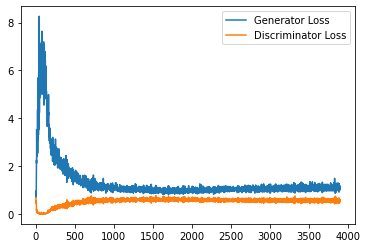

Step 78500: Generator loss: 1.1103830633163452, discriminator loss: 0.5629081376791001


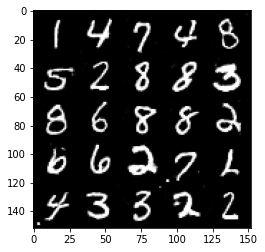

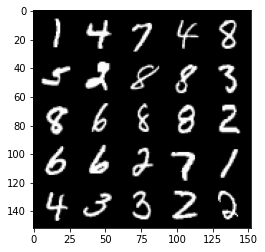

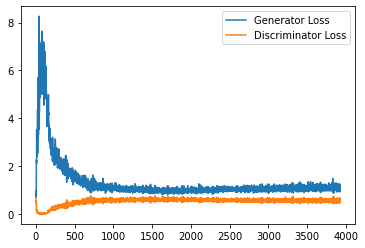

Step 79000: Generator loss: 1.0882711900472641, discriminator loss: 0.5725119948983193


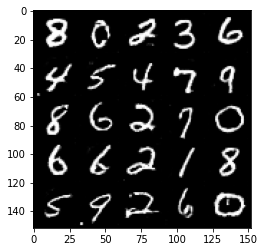

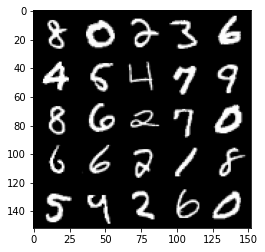

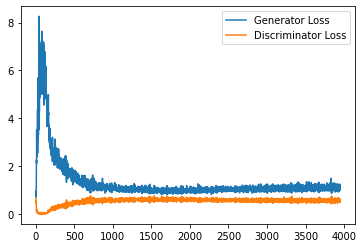

Step 79500: Generator loss: 1.0970698751211165, discriminator loss: 0.5664366696476937


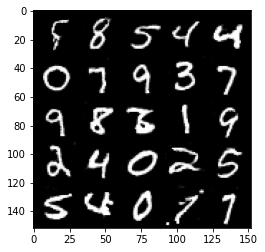

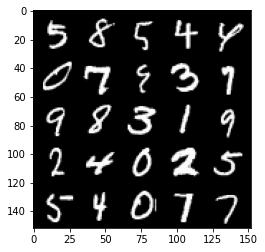

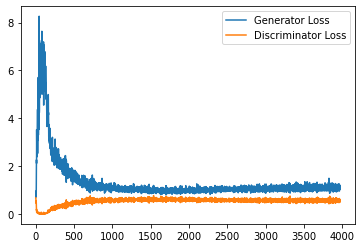

Step 80000: Generator loss: 1.0879966039657594, discriminator loss: 0.5751177835464477


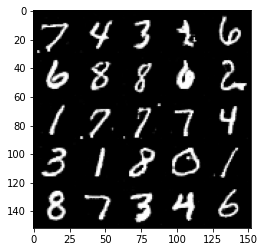

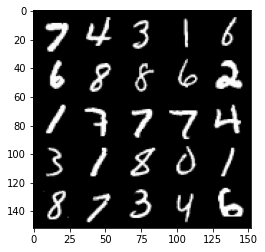

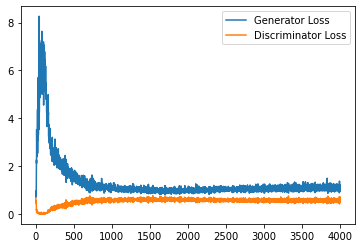

Step 80500: Generator loss: 1.097061120033264, discriminator loss: 0.568539544403553


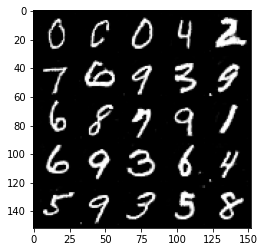

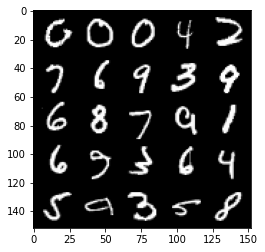

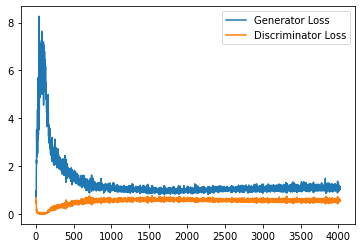

Step 81000: Generator loss: 1.0872867648601532, discriminator loss: 0.5739128717184067


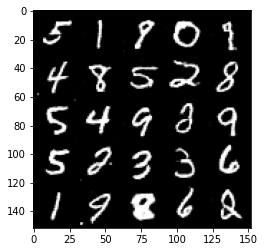

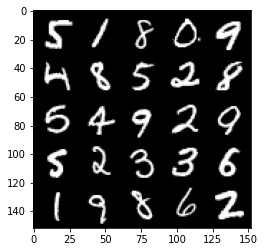

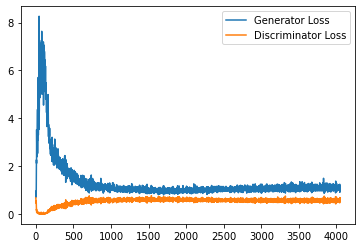

Step 81500: Generator loss: 1.1053482036590576, discriminator loss: 0.5758801144957543


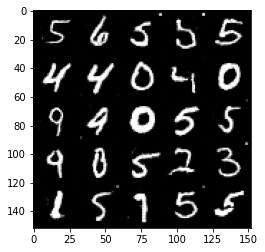

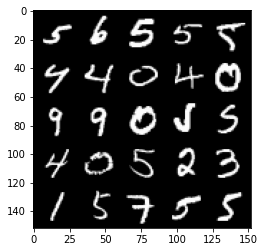

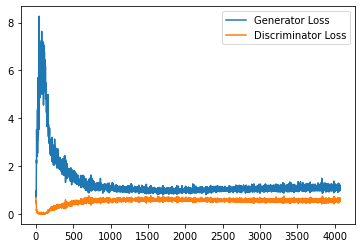

Step 82000: Generator loss: 1.0784049023389817, discriminator loss: 0.5733325607776641


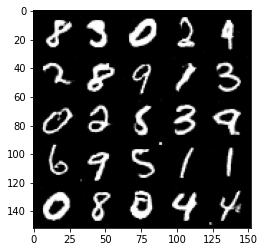

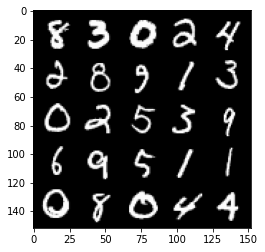

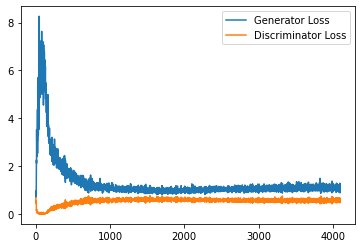

Step 82500: Generator loss: 1.0618684734106063, discriminator loss: 0.5747983509302139


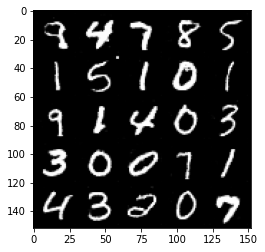

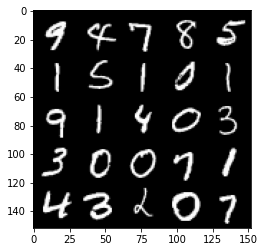

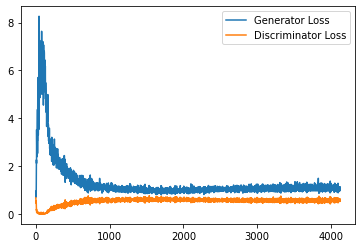

Step 83000: Generator loss: 1.0940661606788635, discriminator loss: 0.5758483234643936


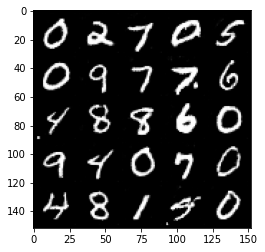

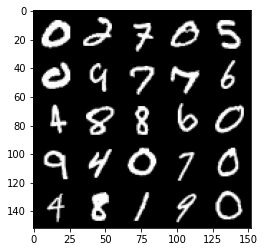

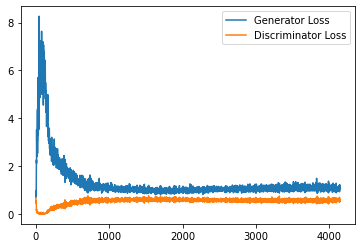

Step 83500: Generator loss: 1.0850785102844238, discriminator loss: 0.5760890510678291


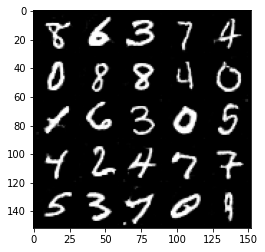

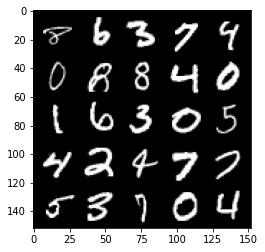

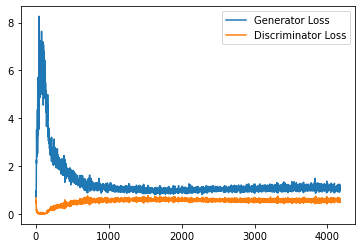

Step 84000: Generator loss: 1.0657389048337937, discriminator loss: 0.5737846212387085


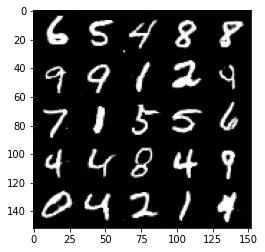

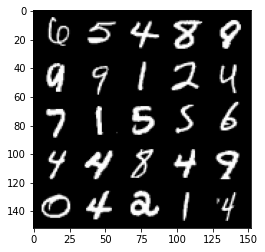

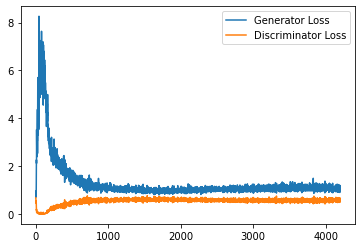

Step 84500: Generator loss: 1.1166724348068238, discriminator loss: 0.5721005785465241


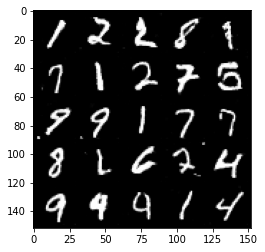

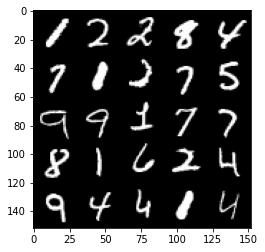

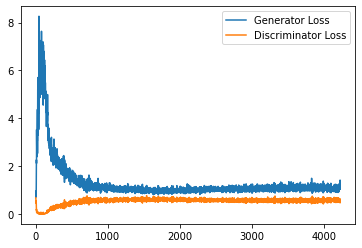

Step 85000: Generator loss: 1.0505302137136459, discriminator loss: 0.5879065470695496


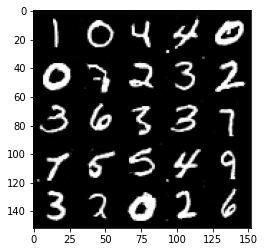

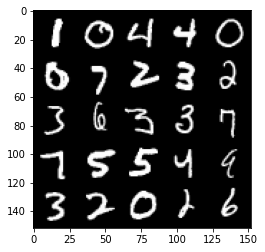

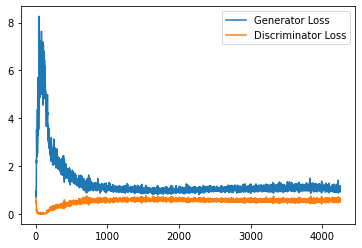

Step 85500: Generator loss: 1.0690413233041762, discriminator loss: 0.5760172411203385


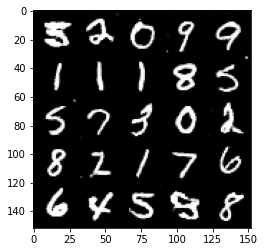

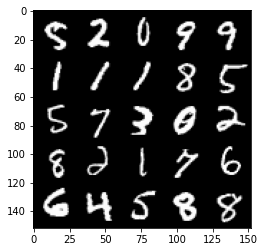

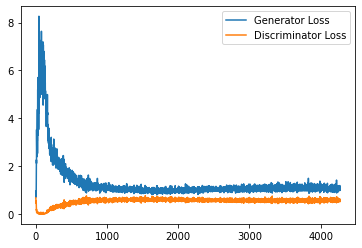

Step 86000: Generator loss: 1.0811683632135392, discriminator loss: 0.5844470507502556


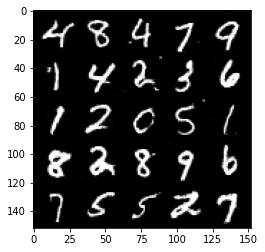

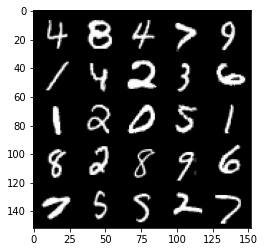

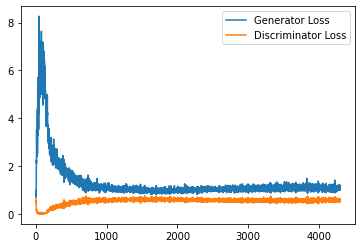

Step 86500: Generator loss: 1.075389571249485, discriminator loss: 0.5860792630910874


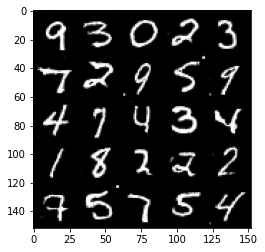

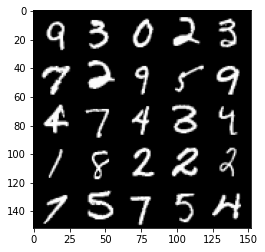

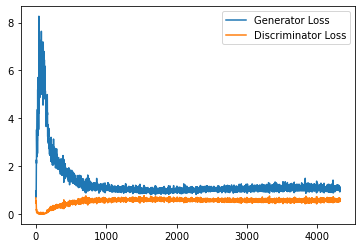

Step 87000: Generator loss: 1.059568634390831, discriminator loss: 0.581860302388668


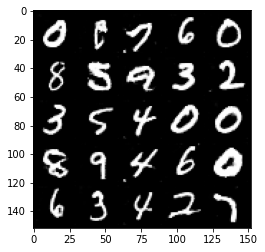

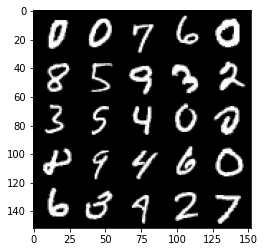

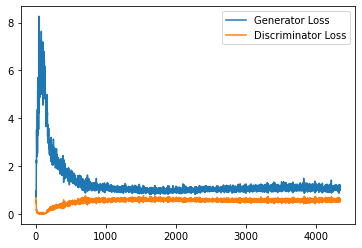

Step 87500: Generator loss: 1.0535236331224442, discriminator loss: 0.5875651447772979


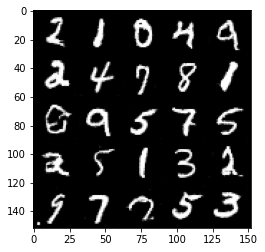

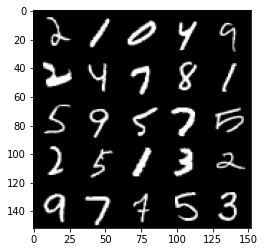

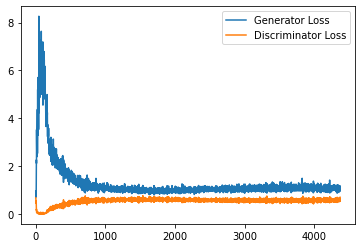

Step 88000: Generator loss: 1.058822981595993, discriminator loss: 0.5820099048614502


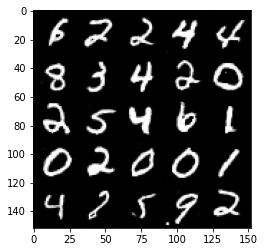

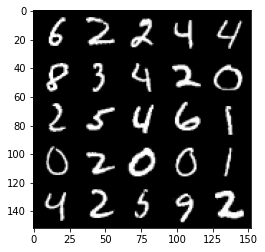

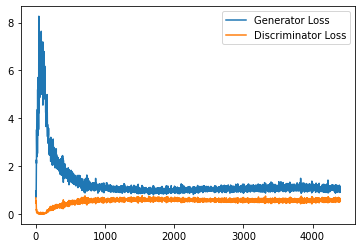

Step 88500: Generator loss: 1.0499489642381667, discriminator loss: 0.5863645367026329


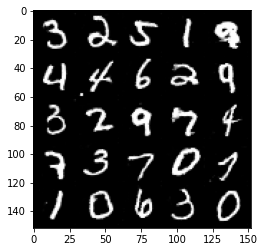

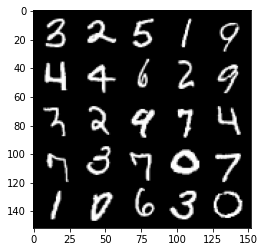

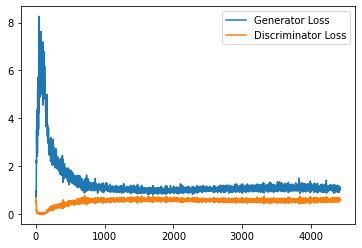

Step 89000: Generator loss: 1.0700124680995942, discriminator loss: 0.5964865046143532


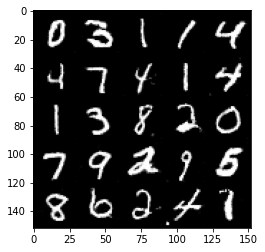

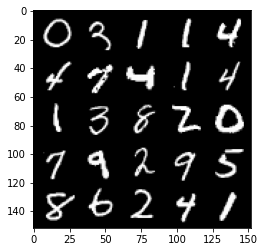

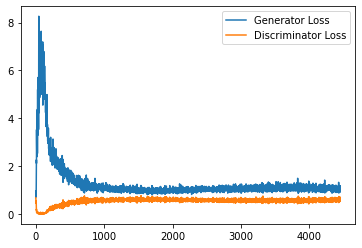

Step 89500: Generator loss: 1.0633755320310592, discriminator loss: 0.590076399564743


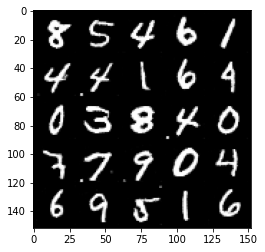

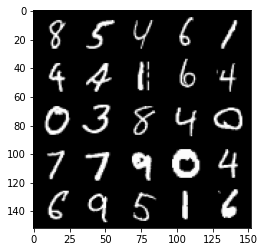

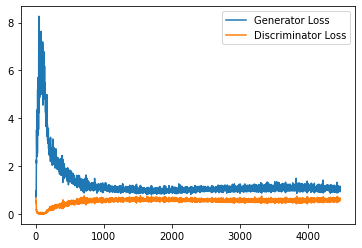

Step 90000: Generator loss: 1.0533735402822495, discriminator loss: 0.587958616912365


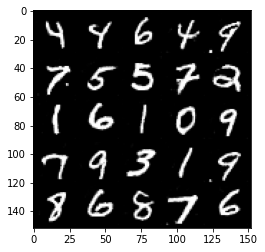

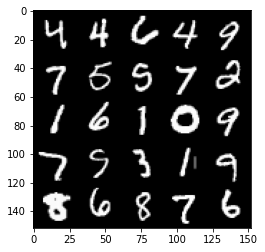

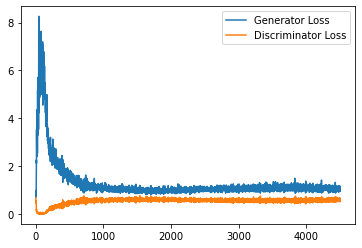

Step 90500: Generator loss: 1.0408022060394286, discriminator loss: 0.5905537507534027


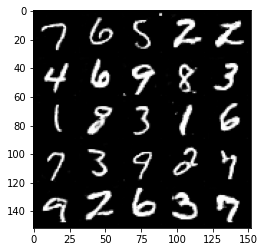

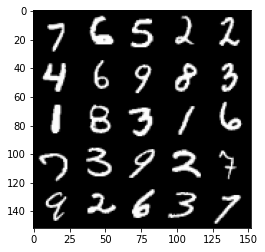

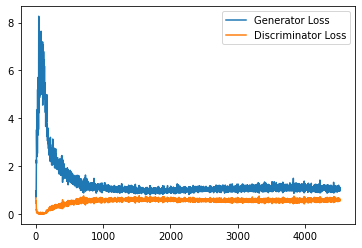

Step 91000: Generator loss: 1.0508067835569381, discriminator loss: 0.5873415983915329


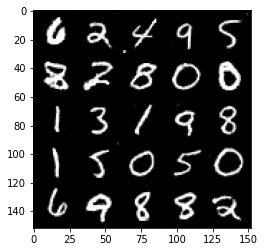

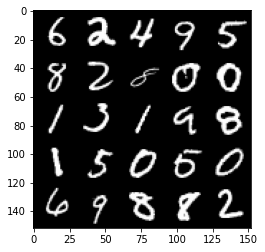

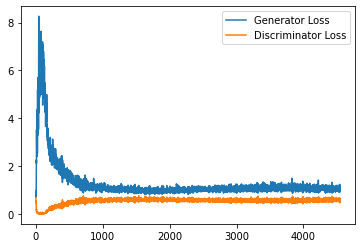

Step 91500: Generator loss: 1.0438210933208465, discriminator loss: 0.5841895698308944


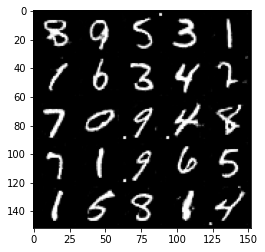

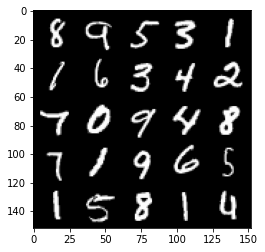

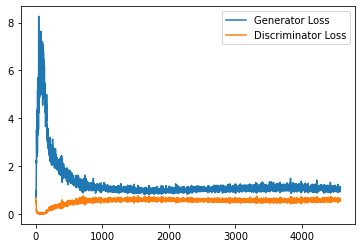

Step 92000: Generator loss: 1.044170214176178, discriminator loss: 0.5916395071744919


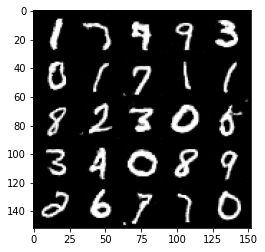

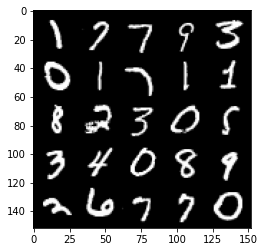

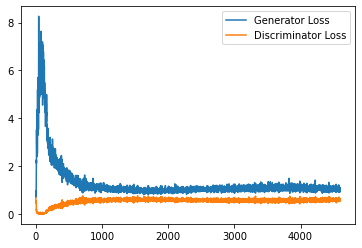

Step 92500: Generator loss: 1.0466419599056245, discriminator loss: 0.5944290285110474


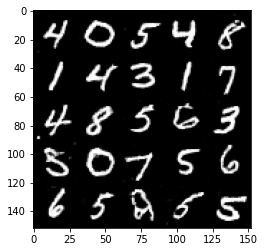

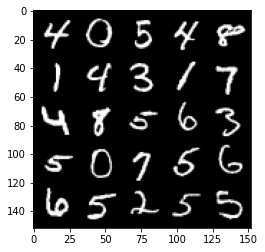

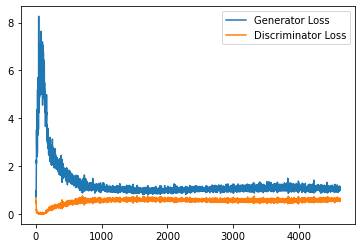

Step 93000: Generator loss: 1.0612700933218002, discriminator loss: 0.5952559360265732


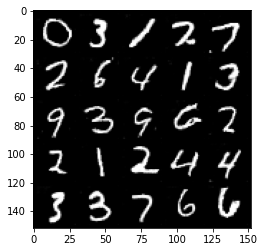

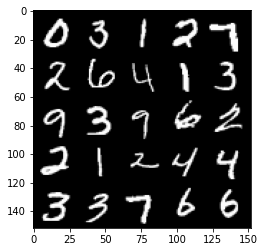

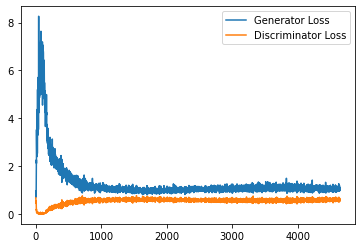

Step 93500: Generator loss: 1.0579705315828323, discriminator loss: 0.5928348137140274


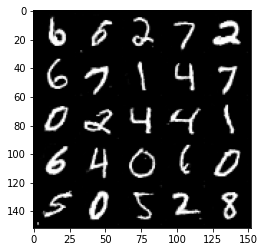

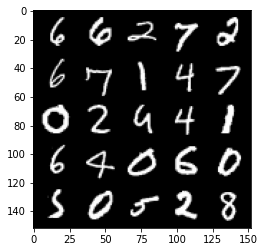

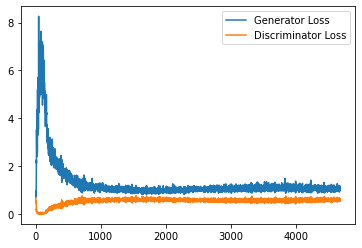

In [14]:

cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
       
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [15]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

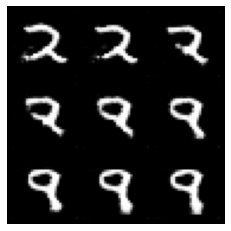

In [18]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 2 # Choose the start digit
### Change me! ###
end_plot_number = 9 # Choose the end digit

plt.figure(figsize=(4, 4))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

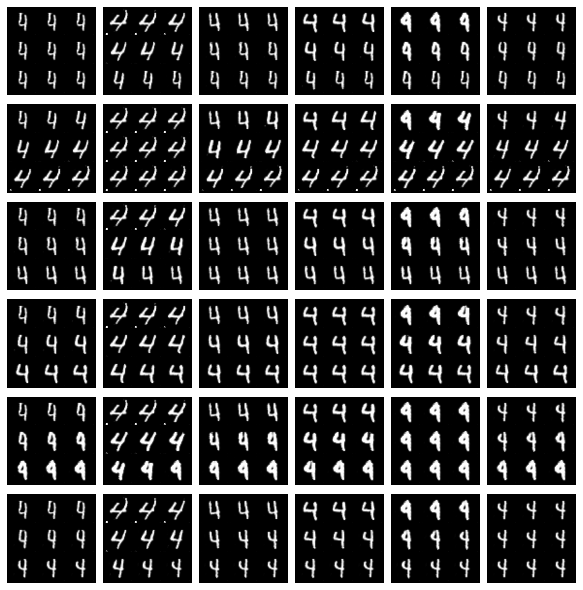

In [22]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([4]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 6 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()